In [1]:
!wget https://openaipublic.blob.core.windows.net/consistency/cd_imagenet64_l2.pt

--2025-03-18 09:00:17--  https://openaipublic.blob.core.windows.net/consistency/cd_imagenet64_l2.pt
Resolving openaipublic.blob.core.windows.net (openaipublic.blob.core.windows.net)... 57.150.97.129
Connecting to openaipublic.blob.core.windows.net (openaipublic.blob.core.windows.net)|57.150.97.129|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1183765127 (1,1G) [application/octet-stream]
Saving to: ‘cd_imagenet64_l2.pt’

cd_imagenet64_l2.pt 100%[===================>]   1,10G  10,8MB/s    in 1m 47s  

2025-03-18 09:02:04 (10,6 MB/s) - ‘cd_imagenet64_l2.pt’ saved [1183765127/1183765127]



In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import torch

# Define the path to the downloaded model
model_path = "cd_imagenet64_l2.pt"

# Load the model checkpoint
checkpoint = torch.load(model_path, map_location="cpu")

# Check what keys are in the checkpoint
print(checkpoint.keys())

dict_keys(['time_embed.0.weight', 'time_embed.0.bias', 'time_embed.2.weight', 'time_embed.2.bias', 'label_emb.weight', 'input_blocks.0.0.weight', 'input_blocks.0.0.bias', 'input_blocks.1.0.in_layers.0.weight', 'input_blocks.1.0.in_layers.0.bias', 'input_blocks.1.0.in_layers.2.weight', 'input_blocks.1.0.in_layers.2.bias', 'input_blocks.1.0.emb_layers.1.weight', 'input_blocks.1.0.emb_layers.1.bias', 'input_blocks.1.0.out_layers.0.weight', 'input_blocks.1.0.out_layers.0.bias', 'input_blocks.1.0.out_layers.3.weight', 'input_blocks.1.0.out_layers.3.bias', 'input_blocks.2.0.in_layers.0.weight', 'input_blocks.2.0.in_layers.0.bias', 'input_blocks.2.0.in_layers.2.weight', 'input_blocks.2.0.in_layers.2.bias', 'input_blocks.2.0.emb_layers.1.weight', 'input_blocks.2.0.emb_layers.1.bias', 'input_blocks.2.0.out_layers.0.weight', 'input_blocks.2.0.out_layers.0.bias', 'input_blocks.2.0.out_layers.3.weight', 'input_blocks.2.0.out_layers.3.bias', 'input_blocks.3.0.in_layers.0.weight', 'input_blocks.3.0.

In [ ]:
checkpoint

In [3]:
from openai_unet import UNetModel

In [4]:

def create_model(
    image_size,
    num_channels,
    num_res_blocks,
    channel_mult="",
    learn_sigma=False,
    class_cond=False,
    use_checkpoint=False,
    attention_resolutions="16",
    num_heads=1,
    num_head_channels=-1,
    num_heads_upsample=-1,
    use_scale_shift_norm=False,
    dropout=0,
    resblock_updown=False,
    use_fp16=False,
    use_new_attention_order=False):

    if channel_mult == "":
        if image_size == 512:
            channel_mult = (0.5, 1, 1, 2, 2, 4, 4)
        elif image_size == 256:
            channel_mult = (1, 1, 2, 2, 4, 4)
        elif image_size == 128:
            channel_mult = (1, 1, 2, 3, 4)
        elif image_size == 64:
            channel_mult = (1, 2, 3, 4)
        else:
            raise ValueError(f"unsupported image size: {image_size}")
    else:
        channel_mult = tuple(int(ch_mult) for ch_mult in channel_mult.split(","))

    attention_ds = []
    for res in attention_resolutions.split(","):
        attention_ds.append(image_size // int(res))

    return UNetModel(
        image_size=image_size,
        in_channels=3,
        model_channels=num_channels,
        out_channels=(3 if not learn_sigma else 6),
        num_res_blocks=num_res_blocks,
        attention_resolutions=tuple(attention_ds),
        dropout=dropout,
        channel_mult=channel_mult,
        num_classes=(NUM_CLASSES if class_cond else None),
        use_checkpoint=use_checkpoint,
        use_fp16=use_fp16,
        num_heads=num_heads,
        num_head_channels=num_head_channels,
        num_heads_upsample=num_heads_upsample,
        use_scale_shift_norm=use_scale_shift_norm,
        resblock_updown=resblock_updown,
        use_new_attention_order=use_new_attention_order,
    )



In [5]:
from flash_attn import Flas

ImportError: cannot import name 'Flas' from 'flash_attn' (/raid/home/detectionfeuxdeforet/caillaud_gab/mds_project/venv_llama/lib/python3.10/site-packages/flash_attn/__init__.py)

In [9]:
cd_model = create_model(image_size=64, num_channels=192, num_head_channels=64, num_res_blocks=3, resblock_updown=True, use_fp16 =True, use_checkpoint=True)

In [10]:
print(cd_model)

UNetModel(
  (time_embed): Sequential(
    (0): Linear(in_features=192, out_features=768, bias=True)
    (1): SiLU()
    (2): Linear(in_features=768, out_features=768, bias=True)
  )
  (input_blocks): ModuleList(
    (0): TimestepEmbedSequential(
      (0): Conv2d(3, 192, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    )
    (1-3): 3 x TimestepEmbedSequential(
      (0): ResBlock(
        (in_layers): Sequential(
          (0): GroupNorm32(32, 192, eps=1e-05, affine=True)
          (1): SiLU()
          (2): Conv2d(192, 192, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        )
        (h_upd): Identity()
        (x_upd): Identity()
        (emb_layers): Sequential(
          (0): SiLU()
          (1): Linear(in_features=768, out_features=192, bias=True)
        )
        (out_layers): Sequential(
          (0): GroupNorm32(32, 192, eps=1e-05, affine=True)
          (1): SiLU()
          (2): Dropout(p=0, inplace=False)
          (3): Conv2d(192, 192, kernel_size=(3, 3), 

In [11]:
cd_model.load_state_dict(checkpoint)

RuntimeError: Error(s) in loading state_dict for UNetModel:
	Missing key(s) in state_dict: "output_blocks.3.1.in_layers.0.weight", "output_blocks.3.1.in_layers.0.bias", "output_blocks.3.1.in_layers.2.weight", "output_blocks.3.1.in_layers.2.bias", "output_blocks.3.1.emb_layers.1.weight", "output_blocks.3.1.emb_layers.1.bias", "output_blocks.3.1.out_layers.0.weight", "output_blocks.3.1.out_layers.0.bias", "output_blocks.3.1.out_layers.3.weight", "output_blocks.3.1.out_layers.3.bias", "output_blocks.11.1.in_layers.0.weight", "output_blocks.11.1.in_layers.0.bias", "output_blocks.11.1.in_layers.2.weight", "output_blocks.11.1.in_layers.2.bias", "output_blocks.11.1.emb_layers.1.weight", "output_blocks.11.1.emb_layers.1.bias", "output_blocks.11.1.out_layers.0.weight", "output_blocks.11.1.out_layers.0.bias", "output_blocks.11.1.out_layers.3.weight", "output_blocks.11.1.out_layers.3.bias". 
	Unexpected key(s) in state_dict: "label_emb.weight", "input_blocks.5.1.norm.weight", "input_blocks.5.1.norm.bias", "input_blocks.5.1.qkv.weight", "input_blocks.5.1.qkv.bias", "input_blocks.5.1.proj_out.weight", "input_blocks.5.1.proj_out.bias", "input_blocks.6.1.norm.weight", "input_blocks.6.1.norm.bias", "input_blocks.6.1.qkv.weight", "input_blocks.6.1.qkv.bias", "input_blocks.6.1.proj_out.weight", "input_blocks.6.1.proj_out.bias", "input_blocks.7.1.norm.weight", "input_blocks.7.1.norm.bias", "input_blocks.7.1.qkv.weight", "input_blocks.7.1.qkv.bias", "input_blocks.7.1.proj_out.weight", "input_blocks.7.1.proj_out.bias", "input_blocks.13.1.norm.weight", "input_blocks.13.1.norm.bias", "input_blocks.13.1.qkv.weight", "input_blocks.13.1.qkv.bias", "input_blocks.13.1.proj_out.weight", "input_blocks.13.1.proj_out.bias", "input_blocks.14.1.norm.weight", "input_blocks.14.1.norm.bias", "input_blocks.14.1.qkv.weight", "input_blocks.14.1.qkv.bias", "input_blocks.14.1.proj_out.weight", "input_blocks.14.1.proj_out.bias", "input_blocks.15.1.norm.weight", "input_blocks.15.1.norm.bias", "input_blocks.15.1.qkv.weight", "input_blocks.15.1.qkv.bias", "input_blocks.15.1.proj_out.weight", "input_blocks.15.1.proj_out.bias", "output_blocks.0.1.norm.weight", "output_blocks.0.1.norm.bias", "output_blocks.0.1.qkv.weight", "output_blocks.0.1.qkv.bias", "output_blocks.0.1.proj_out.weight", "output_blocks.0.1.proj_out.bias", "output_blocks.1.1.norm.weight", "output_blocks.1.1.norm.bias", "output_blocks.1.1.qkv.weight", "output_blocks.1.1.qkv.bias", "output_blocks.1.1.proj_out.weight", "output_blocks.1.1.proj_out.bias", "output_blocks.2.1.norm.weight", "output_blocks.2.1.norm.bias", "output_blocks.2.1.qkv.weight", "output_blocks.2.1.qkv.bias", "output_blocks.2.1.proj_out.weight", "output_blocks.2.1.proj_out.bias", "output_blocks.3.2.in_layers.0.weight", "output_blocks.3.2.in_layers.0.bias", "output_blocks.3.2.in_layers.2.weight", "output_blocks.3.2.in_layers.2.bias", "output_blocks.3.2.emb_layers.1.weight", "output_blocks.3.2.emb_layers.1.bias", "output_blocks.3.2.out_layers.0.weight", "output_blocks.3.2.out_layers.0.bias", "output_blocks.3.2.out_layers.3.weight", "output_blocks.3.2.out_layers.3.bias", "output_blocks.3.1.norm.weight", "output_blocks.3.1.norm.bias", "output_blocks.3.1.qkv.weight", "output_blocks.3.1.qkv.bias", "output_blocks.3.1.proj_out.weight", "output_blocks.3.1.proj_out.bias", "output_blocks.8.1.norm.weight", "output_blocks.8.1.norm.bias", "output_blocks.8.1.qkv.weight", "output_blocks.8.1.qkv.bias", "output_blocks.8.1.proj_out.weight", "output_blocks.8.1.proj_out.bias", "output_blocks.9.1.norm.weight", "output_blocks.9.1.norm.bias", "output_blocks.9.1.qkv.weight", "output_blocks.9.1.qkv.bias", "output_blocks.9.1.proj_out.weight", "output_blocks.9.1.proj_out.bias", "output_blocks.10.1.norm.weight", "output_blocks.10.1.norm.bias", "output_blocks.10.1.qkv.weight", "output_blocks.10.1.qkv.bias", "output_blocks.10.1.proj_out.weight", "output_blocks.10.1.proj_out.bias", "output_blocks.11.2.in_layers.0.weight", "output_blocks.11.2.in_layers.0.bias", "output_blocks.11.2.in_layers.2.weight", "output_blocks.11.2.in_layers.2.bias", "output_blocks.11.2.emb_layers.1.weight", "output_blocks.11.2.emb_layers.1.bias", "output_blocks.11.2.out_layers.0.weight", "output_blocks.11.2.out_layers.0.bias", "output_blocks.11.2.out_layers.3.weight", "output_blocks.11.2.out_layers.3.bias", "output_blocks.11.1.norm.weight", "output_blocks.11.1.norm.bias", "output_blocks.11.1.qkv.weight", "output_blocks.11.1.qkv.bias", "output_blocks.11.1.proj_out.weight", "output_blocks.11.1.proj_out.bias". 
	size mismatch for input_blocks.1.0.emb_layers.1.weight: copying a param with shape torch.Size([384, 768]) from checkpoint, the shape in current model is torch.Size([192, 768]).
	size mismatch for input_blocks.1.0.emb_layers.1.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.2.0.emb_layers.1.weight: copying a param with shape torch.Size([384, 768]) from checkpoint, the shape in current model is torch.Size([192, 768]).
	size mismatch for input_blocks.2.0.emb_layers.1.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.3.0.emb_layers.1.weight: copying a param with shape torch.Size([384, 768]) from checkpoint, the shape in current model is torch.Size([192, 768]).
	size mismatch for input_blocks.3.0.emb_layers.1.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.4.0.emb_layers.1.weight: copying a param with shape torch.Size([384, 768]) from checkpoint, the shape in current model is torch.Size([192, 768]).
	size mismatch for input_blocks.4.0.emb_layers.1.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.5.0.emb_layers.1.weight: copying a param with shape torch.Size([768, 768]) from checkpoint, the shape in current model is torch.Size([384, 768]).
	size mismatch for input_blocks.5.0.emb_layers.1.bias: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.6.0.emb_layers.1.weight: copying a param with shape torch.Size([768, 768]) from checkpoint, the shape in current model is torch.Size([384, 768]).
	size mismatch for input_blocks.6.0.emb_layers.1.bias: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.7.0.emb_layers.1.weight: copying a param with shape torch.Size([768, 768]) from checkpoint, the shape in current model is torch.Size([384, 768]).
	size mismatch for input_blocks.7.0.emb_layers.1.bias: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.8.0.emb_layers.1.weight: copying a param with shape torch.Size([768, 768]) from checkpoint, the shape in current model is torch.Size([384, 768]).
	size mismatch for input_blocks.8.0.emb_layers.1.bias: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.9.0.emb_layers.1.weight: copying a param with shape torch.Size([1152, 768]) from checkpoint, the shape in current model is torch.Size([576, 768]).
	size mismatch for input_blocks.9.0.emb_layers.1.bias: copying a param with shape torch.Size([1152]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for input_blocks.10.0.emb_layers.1.weight: copying a param with shape torch.Size([1152, 768]) from checkpoint, the shape in current model is torch.Size([576, 768]).
	size mismatch for input_blocks.10.0.emb_layers.1.bias: copying a param with shape torch.Size([1152]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for input_blocks.11.0.emb_layers.1.weight: copying a param with shape torch.Size([1152, 768]) from checkpoint, the shape in current model is torch.Size([576, 768]).
	size mismatch for input_blocks.11.0.emb_layers.1.bias: copying a param with shape torch.Size([1152]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for input_blocks.12.0.emb_layers.1.weight: copying a param with shape torch.Size([1152, 768]) from checkpoint, the shape in current model is torch.Size([576, 768]).
	size mismatch for input_blocks.12.0.emb_layers.1.bias: copying a param with shape torch.Size([1152]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for input_blocks.13.0.emb_layers.1.weight: copying a param with shape torch.Size([1536, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for input_blocks.13.0.emb_layers.1.bias: copying a param with shape torch.Size([1536]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for input_blocks.14.0.emb_layers.1.weight: copying a param with shape torch.Size([1536, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for input_blocks.14.0.emb_layers.1.bias: copying a param with shape torch.Size([1536]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for input_blocks.15.0.emb_layers.1.weight: copying a param with shape torch.Size([1536, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for input_blocks.15.0.emb_layers.1.bias: copying a param with shape torch.Size([1536]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for middle_block.0.emb_layers.1.weight: copying a param with shape torch.Size([1536, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for middle_block.0.emb_layers.1.bias: copying a param with shape torch.Size([1536]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for middle_block.2.emb_layers.1.weight: copying a param with shape torch.Size([1536, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for middle_block.2.emb_layers.1.bias: copying a param with shape torch.Size([1536]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for output_blocks.0.0.emb_layers.1.weight: copying a param with shape torch.Size([1536, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for output_blocks.0.0.emb_layers.1.bias: copying a param with shape torch.Size([1536]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for output_blocks.1.0.emb_layers.1.weight: copying a param with shape torch.Size([1536, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for output_blocks.1.0.emb_layers.1.bias: copying a param with shape torch.Size([1536]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for output_blocks.2.0.emb_layers.1.weight: copying a param with shape torch.Size([1536, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for output_blocks.2.0.emb_layers.1.bias: copying a param with shape torch.Size([1536]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for output_blocks.3.0.emb_layers.1.weight: copying a param with shape torch.Size([1536, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for output_blocks.3.0.emb_layers.1.bias: copying a param with shape torch.Size([1536]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for output_blocks.4.0.emb_layers.1.weight: copying a param with shape torch.Size([1152, 768]) from checkpoint, the shape in current model is torch.Size([576, 768]).
	size mismatch for output_blocks.4.0.emb_layers.1.bias: copying a param with shape torch.Size([1152]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for output_blocks.5.0.emb_layers.1.weight: copying a param with shape torch.Size([1152, 768]) from checkpoint, the shape in current model is torch.Size([576, 768]).
	size mismatch for output_blocks.5.0.emb_layers.1.bias: copying a param with shape torch.Size([1152]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for output_blocks.6.0.emb_layers.1.weight: copying a param with shape torch.Size([1152, 768]) from checkpoint, the shape in current model is torch.Size([576, 768]).
	size mismatch for output_blocks.6.0.emb_layers.1.bias: copying a param with shape torch.Size([1152]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for output_blocks.7.0.emb_layers.1.weight: copying a param with shape torch.Size([1152, 768]) from checkpoint, the shape in current model is torch.Size([576, 768]).
	size mismatch for output_blocks.7.0.emb_layers.1.bias: copying a param with shape torch.Size([1152]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for output_blocks.7.2.emb_layers.1.weight: copying a param with shape torch.Size([1152, 768]) from checkpoint, the shape in current model is torch.Size([576, 768]).
	size mismatch for output_blocks.7.2.emb_layers.1.bias: copying a param with shape torch.Size([1152]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for output_blocks.8.0.emb_layers.1.weight: copying a param with shape torch.Size([768, 768]) from checkpoint, the shape in current model is torch.Size([384, 768]).
	size mismatch for output_blocks.8.0.emb_layers.1.bias: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for output_blocks.9.0.emb_layers.1.weight: copying a param with shape torch.Size([768, 768]) from checkpoint, the shape in current model is torch.Size([384, 768]).
	size mismatch for output_blocks.9.0.emb_layers.1.bias: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for output_blocks.10.0.emb_layers.1.weight: copying a param with shape torch.Size([768, 768]) from checkpoint, the shape in current model is torch.Size([384, 768]).
	size mismatch for output_blocks.10.0.emb_layers.1.bias: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for output_blocks.11.0.emb_layers.1.weight: copying a param with shape torch.Size([768, 768]) from checkpoint, the shape in current model is torch.Size([384, 768]).
	size mismatch for output_blocks.11.0.emb_layers.1.bias: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for output_blocks.12.0.emb_layers.1.weight: copying a param with shape torch.Size([384, 768]) from checkpoint, the shape in current model is torch.Size([192, 768]).
	size mismatch for output_blocks.12.0.emb_layers.1.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for output_blocks.13.0.emb_layers.1.weight: copying a param with shape torch.Size([384, 768]) from checkpoint, the shape in current model is torch.Size([192, 768]).
	size mismatch for output_blocks.13.0.emb_layers.1.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for output_blocks.14.0.emb_layers.1.weight: copying a param with shape torch.Size([384, 768]) from checkpoint, the shape in current model is torch.Size([192, 768]).
	size mismatch for output_blocks.14.0.emb_layers.1.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for output_blocks.15.0.emb_layers.1.weight: copying a param with shape torch.Size([384, 768]) from checkpoint, the shape in current model is torch.Size([192, 768]).
	size mismatch for output_blocks.15.0.emb_layers.1.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).

In [16]:
NUM_CLASSES = 1000
cd_model = create_model(
    image_size=64,  # Keep this as your checkpoint was trained on 64x64 images
    num_channels=192,  # Matches input_blocks.0.0.weight
    num_res_blocks=3,  # Keep same as before
    channel_mult="1,1,2,3,4",  # Ensure this matches checkpoint
    learn_sigma=False,  # Keep same as before
    class_cond=True,  # MUST be True since `label_emb.weight` exists
    use_checkpoint=True,  # Matches original model
    attention_resolutions="32,16,8",  # Keep same
    num_heads=1,  # Matches what you had before
    num_head_channels=64,  # Matches what you had before
    num_heads_upsample=-1,  # Keep same
    use_scale_shift_norm=False,  # Keep same
    dropout=0,  # Keep same
    resblock_updown=True,  # Matches original model
    use_fp16=True,  # Matches original model
    use_new_attention_order=False  # Keep same
)

cd_model.load_state_dict(checkpoint)

RuntimeError: Error(s) in loading state_dict for UNetModel:
	Missing key(s) in state_dict: "input_blocks.16.0.in_layers.0.weight", "input_blocks.16.0.in_layers.0.bias", "input_blocks.16.0.in_layers.2.weight", "input_blocks.16.0.in_layers.2.bias", "input_blocks.16.0.emb_layers.1.weight", "input_blocks.16.0.emb_layers.1.bias", "input_blocks.16.0.out_layers.0.weight", "input_blocks.16.0.out_layers.0.bias", "input_blocks.16.0.out_layers.3.weight", "input_blocks.16.0.out_layers.3.bias", "input_blocks.17.0.in_layers.0.weight", "input_blocks.17.0.in_layers.0.bias", "input_blocks.17.0.in_layers.2.weight", "input_blocks.17.0.in_layers.2.bias", "input_blocks.17.0.emb_layers.1.weight", "input_blocks.17.0.emb_layers.1.bias", "input_blocks.17.0.out_layers.0.weight", "input_blocks.17.0.out_layers.0.bias", "input_blocks.17.0.out_layers.3.weight", "input_blocks.17.0.out_layers.3.bias", "input_blocks.17.0.skip_connection.weight", "input_blocks.17.0.skip_connection.bias", "input_blocks.18.0.in_layers.0.weight", "input_blocks.18.0.in_layers.0.bias", "input_blocks.18.0.in_layers.2.weight", "input_blocks.18.0.in_layers.2.bias", "input_blocks.18.0.emb_layers.1.weight", "input_blocks.18.0.emb_layers.1.bias", "input_blocks.18.0.out_layers.0.weight", "input_blocks.18.0.out_layers.0.bias", "input_blocks.18.0.out_layers.3.weight", "input_blocks.18.0.out_layers.3.bias", "input_blocks.19.0.in_layers.0.weight", "input_blocks.19.0.in_layers.0.bias", "input_blocks.19.0.in_layers.2.weight", "input_blocks.19.0.in_layers.2.bias", "input_blocks.19.0.emb_layers.1.weight", "input_blocks.19.0.emb_layers.1.bias", "input_blocks.19.0.out_layers.0.weight", "input_blocks.19.0.out_layers.0.bias", "input_blocks.19.0.out_layers.3.weight", "input_blocks.19.0.out_layers.3.bias", "output_blocks.3.1.in_layers.0.weight", "output_blocks.3.1.in_layers.0.bias", "output_blocks.3.1.in_layers.2.weight", "output_blocks.3.1.in_layers.2.bias", "output_blocks.3.1.emb_layers.1.weight", "output_blocks.3.1.emb_layers.1.bias", "output_blocks.3.1.out_layers.0.weight", "output_blocks.3.1.out_layers.0.bias", "output_blocks.3.1.out_layers.3.weight", "output_blocks.3.1.out_layers.3.bias", "output_blocks.12.1.norm.weight", "output_blocks.12.1.norm.bias", "output_blocks.12.1.qkv.weight", "output_blocks.12.1.qkv.bias", "output_blocks.12.1.proj_out.weight", "output_blocks.12.1.proj_out.bias", "output_blocks.13.1.norm.weight", "output_blocks.13.1.norm.bias", "output_blocks.13.1.qkv.weight", "output_blocks.13.1.qkv.bias", "output_blocks.13.1.proj_out.weight", "output_blocks.13.1.proj_out.bias", "output_blocks.14.1.norm.weight", "output_blocks.14.1.norm.bias", "output_blocks.14.1.qkv.weight", "output_blocks.14.1.qkv.bias", "output_blocks.14.1.proj_out.weight", "output_blocks.14.1.proj_out.bias", "output_blocks.15.1.norm.weight", "output_blocks.15.1.norm.bias", "output_blocks.15.1.qkv.weight", "output_blocks.15.1.qkv.bias", "output_blocks.15.1.proj_out.weight", "output_blocks.15.1.proj_out.bias", "output_blocks.15.2.in_layers.0.weight", "output_blocks.15.2.in_layers.0.bias", "output_blocks.15.2.in_layers.2.weight", "output_blocks.15.2.in_layers.2.bias", "output_blocks.15.2.emb_layers.1.weight", "output_blocks.15.2.emb_layers.1.bias", "output_blocks.15.2.out_layers.0.weight", "output_blocks.15.2.out_layers.0.bias", "output_blocks.15.2.out_layers.3.weight", "output_blocks.15.2.out_layers.3.bias", "output_blocks.16.0.in_layers.0.weight", "output_blocks.16.0.in_layers.0.bias", "output_blocks.16.0.in_layers.2.weight", "output_blocks.16.0.in_layers.2.bias", "output_blocks.16.0.emb_layers.1.weight", "output_blocks.16.0.emb_layers.1.bias", "output_blocks.16.0.out_layers.0.weight", "output_blocks.16.0.out_layers.0.bias", "output_blocks.16.0.out_layers.3.weight", "output_blocks.16.0.out_layers.3.bias", "output_blocks.16.0.skip_connection.weight", "output_blocks.16.0.skip_connection.bias", "output_blocks.17.0.in_layers.0.weight", "output_blocks.17.0.in_layers.0.bias", "output_blocks.17.0.in_layers.2.weight", "output_blocks.17.0.in_layers.2.bias", "output_blocks.17.0.emb_layers.1.weight", "output_blocks.17.0.emb_layers.1.bias", "output_blocks.17.0.out_layers.0.weight", "output_blocks.17.0.out_layers.0.bias", "output_blocks.17.0.out_layers.3.weight", "output_blocks.17.0.out_layers.3.bias", "output_blocks.17.0.skip_connection.weight", "output_blocks.17.0.skip_connection.bias", "output_blocks.18.0.in_layers.0.weight", "output_blocks.18.0.in_layers.0.bias", "output_blocks.18.0.in_layers.2.weight", "output_blocks.18.0.in_layers.2.bias", "output_blocks.18.0.emb_layers.1.weight", "output_blocks.18.0.emb_layers.1.bias", "output_blocks.18.0.out_layers.0.weight", "output_blocks.18.0.out_layers.0.bias", "output_blocks.18.0.out_layers.3.weight", "output_blocks.18.0.out_layers.3.bias", "output_blocks.18.0.skip_connection.weight", "output_blocks.18.0.skip_connection.bias", "output_blocks.19.0.in_layers.0.weight", "output_blocks.19.0.in_layers.0.bias", "output_blocks.19.0.in_layers.2.weight", "output_blocks.19.0.in_layers.2.bias", "output_blocks.19.0.emb_layers.1.weight", "output_blocks.19.0.emb_layers.1.bias", "output_blocks.19.0.out_layers.0.weight", "output_blocks.19.0.out_layers.0.bias", "output_blocks.19.0.out_layers.3.weight", "output_blocks.19.0.out_layers.3.bias", "output_blocks.19.0.skip_connection.weight", "output_blocks.19.0.skip_connection.bias". 
	Unexpected key(s) in state_dict: "input_blocks.5.0.skip_connection.weight", "input_blocks.5.0.skip_connection.bias", "output_blocks.0.1.norm.weight", "output_blocks.0.1.norm.bias", "output_blocks.0.1.qkv.weight", "output_blocks.0.1.qkv.bias", "output_blocks.0.1.proj_out.weight", "output_blocks.0.1.proj_out.bias", "output_blocks.1.1.norm.weight", "output_blocks.1.1.norm.bias", "output_blocks.1.1.qkv.weight", "output_blocks.1.1.qkv.bias", "output_blocks.1.1.proj_out.weight", "output_blocks.1.1.proj_out.bias", "output_blocks.2.1.norm.weight", "output_blocks.2.1.norm.bias", "output_blocks.2.1.qkv.weight", "output_blocks.2.1.qkv.bias", "output_blocks.2.1.proj_out.weight", "output_blocks.2.1.proj_out.bias", "output_blocks.3.2.in_layers.0.weight", "output_blocks.3.2.in_layers.0.bias", "output_blocks.3.2.in_layers.2.weight", "output_blocks.3.2.in_layers.2.bias", "output_blocks.3.2.emb_layers.1.weight", "output_blocks.3.2.emb_layers.1.bias", "output_blocks.3.2.out_layers.0.weight", "output_blocks.3.2.out_layers.0.bias", "output_blocks.3.2.out_layers.3.weight", "output_blocks.3.2.out_layers.3.bias", "output_blocks.3.1.norm.weight", "output_blocks.3.1.norm.bias", "output_blocks.3.1.qkv.weight", "output_blocks.3.1.qkv.bias", "output_blocks.3.1.proj_out.weight", "output_blocks.3.1.proj_out.bias". 
	size mismatch for input_blocks.1.0.emb_layers.1.weight: copying a param with shape torch.Size([384, 768]) from checkpoint, the shape in current model is torch.Size([192, 768]).
	size mismatch for input_blocks.1.0.emb_layers.1.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.2.0.emb_layers.1.weight: copying a param with shape torch.Size([384, 768]) from checkpoint, the shape in current model is torch.Size([192, 768]).
	size mismatch for input_blocks.2.0.emb_layers.1.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.3.0.emb_layers.1.weight: copying a param with shape torch.Size([384, 768]) from checkpoint, the shape in current model is torch.Size([192, 768]).
	size mismatch for input_blocks.3.0.emb_layers.1.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.4.0.emb_layers.1.weight: copying a param with shape torch.Size([384, 768]) from checkpoint, the shape in current model is torch.Size([192, 768]).
	size mismatch for input_blocks.4.0.emb_layers.1.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.5.0.in_layers.2.weight: copying a param with shape torch.Size([384, 192, 3, 3]) from checkpoint, the shape in current model is torch.Size([192, 192, 3, 3]).
	size mismatch for input_blocks.5.0.in_layers.2.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.5.0.emb_layers.1.weight: copying a param with shape torch.Size([768, 768]) from checkpoint, the shape in current model is torch.Size([192, 768]).
	size mismatch for input_blocks.5.0.emb_layers.1.bias: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.5.0.out_layers.0.weight: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.5.0.out_layers.0.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.5.0.out_layers.3.weight: copying a param with shape torch.Size([384, 384, 3, 3]) from checkpoint, the shape in current model is torch.Size([192, 192, 3, 3]).
	size mismatch for input_blocks.5.0.out_layers.3.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.5.1.norm.weight: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.5.1.norm.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.5.1.qkv.weight: copying a param with shape torch.Size([1152, 384, 1, 1]) from checkpoint, the shape in current model is torch.Size([576, 192, 1, 1]).
	size mismatch for input_blocks.5.1.qkv.bias: copying a param with shape torch.Size([1152]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for input_blocks.5.1.proj_out.weight: copying a param with shape torch.Size([384, 384, 1, 1]) from checkpoint, the shape in current model is torch.Size([192, 192, 1, 1]).
	size mismatch for input_blocks.5.1.proj_out.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.6.0.in_layers.0.weight: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.6.0.in_layers.0.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.6.0.in_layers.2.weight: copying a param with shape torch.Size([384, 384, 3, 3]) from checkpoint, the shape in current model is torch.Size([192, 192, 3, 3]).
	size mismatch for input_blocks.6.0.in_layers.2.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.6.0.emb_layers.1.weight: copying a param with shape torch.Size([768, 768]) from checkpoint, the shape in current model is torch.Size([192, 768]).
	size mismatch for input_blocks.6.0.emb_layers.1.bias: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.6.0.out_layers.0.weight: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.6.0.out_layers.0.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.6.0.out_layers.3.weight: copying a param with shape torch.Size([384, 384, 3, 3]) from checkpoint, the shape in current model is torch.Size([192, 192, 3, 3]).
	size mismatch for input_blocks.6.0.out_layers.3.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.6.1.norm.weight: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.6.1.norm.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.6.1.qkv.weight: copying a param with shape torch.Size([1152, 384, 1, 1]) from checkpoint, the shape in current model is torch.Size([576, 192, 1, 1]).
	size mismatch for input_blocks.6.1.qkv.bias: copying a param with shape torch.Size([1152]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for input_blocks.6.1.proj_out.weight: copying a param with shape torch.Size([384, 384, 1, 1]) from checkpoint, the shape in current model is torch.Size([192, 192, 1, 1]).
	size mismatch for input_blocks.6.1.proj_out.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.7.0.in_layers.0.weight: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.7.0.in_layers.0.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.7.0.in_layers.2.weight: copying a param with shape torch.Size([384, 384, 3, 3]) from checkpoint, the shape in current model is torch.Size([192, 192, 3, 3]).
	size mismatch for input_blocks.7.0.in_layers.2.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.7.0.emb_layers.1.weight: copying a param with shape torch.Size([768, 768]) from checkpoint, the shape in current model is torch.Size([192, 768]).
	size mismatch for input_blocks.7.0.emb_layers.1.bias: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.7.0.out_layers.0.weight: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.7.0.out_layers.0.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.7.0.out_layers.3.weight: copying a param with shape torch.Size([384, 384, 3, 3]) from checkpoint, the shape in current model is torch.Size([192, 192, 3, 3]).
	size mismatch for input_blocks.7.0.out_layers.3.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.7.1.norm.weight: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.7.1.norm.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.7.1.qkv.weight: copying a param with shape torch.Size([1152, 384, 1, 1]) from checkpoint, the shape in current model is torch.Size([576, 192, 1, 1]).
	size mismatch for input_blocks.7.1.qkv.bias: copying a param with shape torch.Size([1152]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for input_blocks.7.1.proj_out.weight: copying a param with shape torch.Size([384, 384, 1, 1]) from checkpoint, the shape in current model is torch.Size([192, 192, 1, 1]).
	size mismatch for input_blocks.7.1.proj_out.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.8.0.in_layers.0.weight: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.8.0.in_layers.0.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.8.0.in_layers.2.weight: copying a param with shape torch.Size([384, 384, 3, 3]) from checkpoint, the shape in current model is torch.Size([192, 192, 3, 3]).
	size mismatch for input_blocks.8.0.in_layers.2.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.8.0.emb_layers.1.weight: copying a param with shape torch.Size([768, 768]) from checkpoint, the shape in current model is torch.Size([192, 768]).
	size mismatch for input_blocks.8.0.emb_layers.1.bias: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.8.0.out_layers.0.weight: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.8.0.out_layers.0.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.8.0.out_layers.3.weight: copying a param with shape torch.Size([384, 384, 3, 3]) from checkpoint, the shape in current model is torch.Size([192, 192, 3, 3]).
	size mismatch for input_blocks.8.0.out_layers.3.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.9.0.in_layers.0.weight: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.9.0.in_layers.0.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for input_blocks.9.0.in_layers.2.weight: copying a param with shape torch.Size([576, 384, 3, 3]) from checkpoint, the shape in current model is torch.Size([384, 192, 3, 3]).
	size mismatch for input_blocks.9.0.in_layers.2.bias: copying a param with shape torch.Size([576]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.9.0.emb_layers.1.weight: copying a param with shape torch.Size([1152, 768]) from checkpoint, the shape in current model is torch.Size([384, 768]).
	size mismatch for input_blocks.9.0.emb_layers.1.bias: copying a param with shape torch.Size([1152]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.9.0.out_layers.0.weight: copying a param with shape torch.Size([576]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.9.0.out_layers.0.bias: copying a param with shape torch.Size([576]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.9.0.out_layers.3.weight: copying a param with shape torch.Size([576, 576, 3, 3]) from checkpoint, the shape in current model is torch.Size([384, 384, 3, 3]).
	size mismatch for input_blocks.9.0.out_layers.3.bias: copying a param with shape torch.Size([576]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.9.0.skip_connection.weight: copying a param with shape torch.Size([576, 384, 1, 1]) from checkpoint, the shape in current model is torch.Size([384, 192, 1, 1]).
	size mismatch for input_blocks.9.0.skip_connection.bias: copying a param with shape torch.Size([576]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.9.1.norm.weight: copying a param with shape torch.Size([576]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.9.1.norm.bias: copying a param with shape torch.Size([576]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.9.1.qkv.weight: copying a param with shape torch.Size([1728, 576, 1, 1]) from checkpoint, the shape in current model is torch.Size([1152, 384, 1, 1]).
	size mismatch for input_blocks.9.1.qkv.bias: copying a param with shape torch.Size([1728]) from checkpoint, the shape in current model is torch.Size([1152]).
	size mismatch for input_blocks.9.1.proj_out.weight: copying a param with shape torch.Size([576, 576, 1, 1]) from checkpoint, the shape in current model is torch.Size([384, 384, 1, 1]).
	size mismatch for input_blocks.9.1.proj_out.bias: copying a param with shape torch.Size([576]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.10.0.in_layers.0.weight: copying a param with shape torch.Size([576]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.10.0.in_layers.0.bias: copying a param with shape torch.Size([576]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.10.0.in_layers.2.weight: copying a param with shape torch.Size([576, 576, 3, 3]) from checkpoint, the shape in current model is torch.Size([384, 384, 3, 3]).
	size mismatch for input_blocks.10.0.in_layers.2.bias: copying a param with shape torch.Size([576]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.10.0.emb_layers.1.weight: copying a param with shape torch.Size([1152, 768]) from checkpoint, the shape in current model is torch.Size([384, 768]).
	size mismatch for input_blocks.10.0.emb_layers.1.bias: copying a param with shape torch.Size([1152]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.10.0.out_layers.0.weight: copying a param with shape torch.Size([576]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.10.0.out_layers.0.bias: copying a param with shape torch.Size([576]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.10.0.out_layers.3.weight: copying a param with shape torch.Size([576, 576, 3, 3]) from checkpoint, the shape in current model is torch.Size([384, 384, 3, 3]).
	size mismatch for input_blocks.10.0.out_layers.3.bias: copying a param with shape torch.Size([576]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.10.1.norm.weight: copying a param with shape torch.Size([576]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.10.1.norm.bias: copying a param with shape torch.Size([576]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.10.1.qkv.weight: copying a param with shape torch.Size([1728, 576, 1, 1]) from checkpoint, the shape in current model is torch.Size([1152, 384, 1, 1]).
	size mismatch for input_blocks.10.1.qkv.bias: copying a param with shape torch.Size([1728]) from checkpoint, the shape in current model is torch.Size([1152]).
	size mismatch for input_blocks.10.1.proj_out.weight: copying a param with shape torch.Size([576, 576, 1, 1]) from checkpoint, the shape in current model is torch.Size([384, 384, 1, 1]).
	size mismatch for input_blocks.10.1.proj_out.bias: copying a param with shape torch.Size([576]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.11.0.in_layers.0.weight: copying a param with shape torch.Size([576]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.11.0.in_layers.0.bias: copying a param with shape torch.Size([576]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.11.0.in_layers.2.weight: copying a param with shape torch.Size([576, 576, 3, 3]) from checkpoint, the shape in current model is torch.Size([384, 384, 3, 3]).
	size mismatch for input_blocks.11.0.in_layers.2.bias: copying a param with shape torch.Size([576]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.11.0.emb_layers.1.weight: copying a param with shape torch.Size([1152, 768]) from checkpoint, the shape in current model is torch.Size([384, 768]).
	size mismatch for input_blocks.11.0.emb_layers.1.bias: copying a param with shape torch.Size([1152]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.11.0.out_layers.0.weight: copying a param with shape torch.Size([576]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.11.0.out_layers.0.bias: copying a param with shape torch.Size([576]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.11.0.out_layers.3.weight: copying a param with shape torch.Size([576, 576, 3, 3]) from checkpoint, the shape in current model is torch.Size([384, 384, 3, 3]).
	size mismatch for input_blocks.11.0.out_layers.3.bias: copying a param with shape torch.Size([576]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.11.1.norm.weight: copying a param with shape torch.Size([576]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.11.1.norm.bias: copying a param with shape torch.Size([576]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.11.1.qkv.weight: copying a param with shape torch.Size([1728, 576, 1, 1]) from checkpoint, the shape in current model is torch.Size([1152, 384, 1, 1]).
	size mismatch for input_blocks.11.1.qkv.bias: copying a param with shape torch.Size([1728]) from checkpoint, the shape in current model is torch.Size([1152]).
	size mismatch for input_blocks.11.1.proj_out.weight: copying a param with shape torch.Size([576, 576, 1, 1]) from checkpoint, the shape in current model is torch.Size([384, 384, 1, 1]).
	size mismatch for input_blocks.11.1.proj_out.bias: copying a param with shape torch.Size([576]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.12.0.in_layers.0.weight: copying a param with shape torch.Size([576]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.12.0.in_layers.0.bias: copying a param with shape torch.Size([576]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.12.0.in_layers.2.weight: copying a param with shape torch.Size([576, 576, 3, 3]) from checkpoint, the shape in current model is torch.Size([384, 384, 3, 3]).
	size mismatch for input_blocks.12.0.in_layers.2.bias: copying a param with shape torch.Size([576]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.12.0.emb_layers.1.weight: copying a param with shape torch.Size([1152, 768]) from checkpoint, the shape in current model is torch.Size([384, 768]).
	size mismatch for input_blocks.12.0.emb_layers.1.bias: copying a param with shape torch.Size([1152]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.12.0.out_layers.0.weight: copying a param with shape torch.Size([576]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.12.0.out_layers.0.bias: copying a param with shape torch.Size([576]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.12.0.out_layers.3.weight: copying a param with shape torch.Size([576, 576, 3, 3]) from checkpoint, the shape in current model is torch.Size([384, 384, 3, 3]).
	size mismatch for input_blocks.12.0.out_layers.3.bias: copying a param with shape torch.Size([576]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.13.0.in_layers.0.weight: copying a param with shape torch.Size([576]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.13.0.in_layers.0.bias: copying a param with shape torch.Size([576]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for input_blocks.13.0.in_layers.2.weight: copying a param with shape torch.Size([768, 576, 3, 3]) from checkpoint, the shape in current model is torch.Size([576, 384, 3, 3]).
	size mismatch for input_blocks.13.0.in_layers.2.bias: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for input_blocks.13.0.emb_layers.1.weight: copying a param with shape torch.Size([1536, 768]) from checkpoint, the shape in current model is torch.Size([576, 768]).
	size mismatch for input_blocks.13.0.emb_layers.1.bias: copying a param with shape torch.Size([1536]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for input_blocks.13.0.out_layers.0.weight: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for input_blocks.13.0.out_layers.0.bias: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for input_blocks.13.0.out_layers.3.weight: copying a param with shape torch.Size([768, 768, 3, 3]) from checkpoint, the shape in current model is torch.Size([576, 576, 3, 3]).
	size mismatch for input_blocks.13.0.out_layers.3.bias: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for input_blocks.13.0.skip_connection.weight: copying a param with shape torch.Size([768, 576, 1, 1]) from checkpoint, the shape in current model is torch.Size([576, 384, 1, 1]).
	size mismatch for input_blocks.13.0.skip_connection.bias: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for input_blocks.13.1.norm.weight: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for input_blocks.13.1.norm.bias: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for input_blocks.13.1.qkv.weight: copying a param with shape torch.Size([2304, 768, 1, 1]) from checkpoint, the shape in current model is torch.Size([1728, 576, 1, 1]).
	size mismatch for input_blocks.13.1.qkv.bias: copying a param with shape torch.Size([2304]) from checkpoint, the shape in current model is torch.Size([1728]).
	size mismatch for input_blocks.13.1.proj_out.weight: copying a param with shape torch.Size([768, 768, 1, 1]) from checkpoint, the shape in current model is torch.Size([576, 576, 1, 1]).
	size mismatch for input_blocks.13.1.proj_out.bias: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for input_blocks.14.0.in_layers.0.weight: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for input_blocks.14.0.in_layers.0.bias: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for input_blocks.14.0.in_layers.2.weight: copying a param with shape torch.Size([768, 768, 3, 3]) from checkpoint, the shape in current model is torch.Size([576, 576, 3, 3]).
	size mismatch for input_blocks.14.0.in_layers.2.bias: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for input_blocks.14.0.emb_layers.1.weight: copying a param with shape torch.Size([1536, 768]) from checkpoint, the shape in current model is torch.Size([576, 768]).
	size mismatch for input_blocks.14.0.emb_layers.1.bias: copying a param with shape torch.Size([1536]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for input_blocks.14.0.out_layers.0.weight: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for input_blocks.14.0.out_layers.0.bias: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for input_blocks.14.0.out_layers.3.weight: copying a param with shape torch.Size([768, 768, 3, 3]) from checkpoint, the shape in current model is torch.Size([576, 576, 3, 3]).
	size mismatch for input_blocks.14.0.out_layers.3.bias: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for input_blocks.14.1.norm.weight: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for input_blocks.14.1.norm.bias: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for input_blocks.14.1.qkv.weight: copying a param with shape torch.Size([2304, 768, 1, 1]) from checkpoint, the shape in current model is torch.Size([1728, 576, 1, 1]).
	size mismatch for input_blocks.14.1.qkv.bias: copying a param with shape torch.Size([2304]) from checkpoint, the shape in current model is torch.Size([1728]).
	size mismatch for input_blocks.14.1.proj_out.weight: copying a param with shape torch.Size([768, 768, 1, 1]) from checkpoint, the shape in current model is torch.Size([576, 576, 1, 1]).
	size mismatch for input_blocks.14.1.proj_out.bias: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for input_blocks.15.0.in_layers.0.weight: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for input_blocks.15.0.in_layers.0.bias: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for input_blocks.15.0.in_layers.2.weight: copying a param with shape torch.Size([768, 768, 3, 3]) from checkpoint, the shape in current model is torch.Size([576, 576, 3, 3]).
	size mismatch for input_blocks.15.0.in_layers.2.bias: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for input_blocks.15.0.emb_layers.1.weight: copying a param with shape torch.Size([1536, 768]) from checkpoint, the shape in current model is torch.Size([576, 768]).
	size mismatch for input_blocks.15.0.emb_layers.1.bias: copying a param with shape torch.Size([1536]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for input_blocks.15.0.out_layers.0.weight: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for input_blocks.15.0.out_layers.0.bias: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for input_blocks.15.0.out_layers.3.weight: copying a param with shape torch.Size([768, 768, 3, 3]) from checkpoint, the shape in current model is torch.Size([576, 576, 3, 3]).
	size mismatch for input_blocks.15.0.out_layers.3.bias: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for input_blocks.15.1.norm.weight: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for input_blocks.15.1.norm.bias: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for input_blocks.15.1.qkv.weight: copying a param with shape torch.Size([2304, 768, 1, 1]) from checkpoint, the shape in current model is torch.Size([1728, 576, 1, 1]).
	size mismatch for input_blocks.15.1.qkv.bias: copying a param with shape torch.Size([2304]) from checkpoint, the shape in current model is torch.Size([1728]).
	size mismatch for input_blocks.15.1.proj_out.weight: copying a param with shape torch.Size([768, 768, 1, 1]) from checkpoint, the shape in current model is torch.Size([576, 576, 1, 1]).
	size mismatch for input_blocks.15.1.proj_out.bias: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for middle_block.0.emb_layers.1.weight: copying a param with shape torch.Size([1536, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for middle_block.0.emb_layers.1.bias: copying a param with shape torch.Size([1536]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for middle_block.2.emb_layers.1.weight: copying a param with shape torch.Size([1536, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for middle_block.2.emb_layers.1.bias: copying a param with shape torch.Size([1536]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for output_blocks.0.0.emb_layers.1.weight: copying a param with shape torch.Size([1536, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for output_blocks.0.0.emb_layers.1.bias: copying a param with shape torch.Size([1536]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for output_blocks.1.0.emb_layers.1.weight: copying a param with shape torch.Size([1536, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for output_blocks.1.0.emb_layers.1.bias: copying a param with shape torch.Size([1536]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for output_blocks.2.0.emb_layers.1.weight: copying a param with shape torch.Size([1536, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for output_blocks.2.0.emb_layers.1.bias: copying a param with shape torch.Size([1536]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for output_blocks.3.0.emb_layers.1.weight: copying a param with shape torch.Size([1536, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for output_blocks.3.0.emb_layers.1.bias: copying a param with shape torch.Size([1536]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for output_blocks.4.0.emb_layers.1.weight: copying a param with shape torch.Size([1152, 768]) from checkpoint, the shape in current model is torch.Size([576, 768]).
	size mismatch for output_blocks.4.0.emb_layers.1.bias: copying a param with shape torch.Size([1152]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for output_blocks.5.0.emb_layers.1.weight: copying a param with shape torch.Size([1152, 768]) from checkpoint, the shape in current model is torch.Size([576, 768]).
	size mismatch for output_blocks.5.0.emb_layers.1.bias: copying a param with shape torch.Size([1152]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for output_blocks.6.0.emb_layers.1.weight: copying a param with shape torch.Size([1152, 768]) from checkpoint, the shape in current model is torch.Size([576, 768]).
	size mismatch for output_blocks.6.0.emb_layers.1.bias: copying a param with shape torch.Size([1152]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for output_blocks.7.0.emb_layers.1.weight: copying a param with shape torch.Size([1152, 768]) from checkpoint, the shape in current model is torch.Size([576, 768]).
	size mismatch for output_blocks.7.0.emb_layers.1.bias: copying a param with shape torch.Size([1152]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for output_blocks.7.2.emb_layers.1.weight: copying a param with shape torch.Size([1152, 768]) from checkpoint, the shape in current model is torch.Size([576, 768]).
	size mismatch for output_blocks.7.2.emb_layers.1.bias: copying a param with shape torch.Size([1152]) from checkpoint, the shape in current model is torch.Size([576]).
	size mismatch for output_blocks.8.0.emb_layers.1.weight: copying a param with shape torch.Size([768, 768]) from checkpoint, the shape in current model is torch.Size([384, 768]).
	size mismatch for output_blocks.8.0.emb_layers.1.bias: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for output_blocks.9.0.emb_layers.1.weight: copying a param with shape torch.Size([768, 768]) from checkpoint, the shape in current model is torch.Size([384, 768]).
	size mismatch for output_blocks.9.0.emb_layers.1.bias: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for output_blocks.10.0.emb_layers.1.weight: copying a param with shape torch.Size([768, 768]) from checkpoint, the shape in current model is torch.Size([384, 768]).
	size mismatch for output_blocks.10.0.emb_layers.1.bias: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for output_blocks.11.0.emb_layers.1.weight: copying a param with shape torch.Size([768, 768]) from checkpoint, the shape in current model is torch.Size([384, 768]).
	size mismatch for output_blocks.11.0.emb_layers.1.bias: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for output_blocks.11.2.emb_layers.1.weight: copying a param with shape torch.Size([768, 768]) from checkpoint, the shape in current model is torch.Size([384, 768]).
	size mismatch for output_blocks.11.2.emb_layers.1.bias: copying a param with shape torch.Size([768]) from checkpoint, the shape in current model is torch.Size([384]).
	size mismatch for output_blocks.12.0.emb_layers.1.weight: copying a param with shape torch.Size([384, 768]) from checkpoint, the shape in current model is torch.Size([192, 768]).
	size mismatch for output_blocks.12.0.emb_layers.1.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for output_blocks.13.0.emb_layers.1.weight: copying a param with shape torch.Size([384, 768]) from checkpoint, the shape in current model is torch.Size([192, 768]).
	size mismatch for output_blocks.13.0.emb_layers.1.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for output_blocks.14.0.emb_layers.1.weight: copying a param with shape torch.Size([384, 768]) from checkpoint, the shape in current model is torch.Size([192, 768]).
	size mismatch for output_blocks.14.0.emb_layers.1.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).
	size mismatch for output_blocks.15.0.emb_layers.1.weight: copying a param with shape torch.Size([384, 768]) from checkpoint, the shape in current model is torch.Size([192, 768]).
	size mismatch for output_blocks.15.0.emb_layers.1.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([192]).

In [17]:
print(cd_model)

UNetModel(
  (time_embed): Sequential(
    (0): Linear(in_features=192, out_features=768, bias=True)
    (1): SiLU()
    (2): Linear(in_features=768, out_features=768, bias=True)
  )
  (label_emb): Embedding(1000, 768)
  (input_blocks): ModuleList(
    (0): TimestepEmbedSequential(
      (0): Conv2d(3, 192, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    )
    (1-3): 3 x TimestepEmbedSequential(
      (0): ResBlock(
        (in_layers): Sequential(
          (0): GroupNorm32(32, 192, eps=1e-05, affine=True)
          (1): SiLU()
          (2): Conv2d(192, 192, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        )
        (h_upd): Identity()
        (x_upd): Identity()
        (emb_layers): Sequential(
          (0): SiLU()
          (1): Linear(in_features=768, out_features=192, bias=True)
        )
        (out_layers): Sequential(
          (0): GroupNorm32(32, 192, eps=1e-05, affine=True)
          (1): SiLU()
          (2): Dropout(p=0, inplace=False)
          (3): C

In [12]:
for key, value in checkpoint.items():
    print(key, value.shape)

time_embed.0.weight torch.Size([768, 192])
time_embed.0.bias torch.Size([768])
time_embed.2.weight torch.Size([768, 768])
time_embed.2.bias torch.Size([768])
label_emb.weight torch.Size([1000, 768])
input_blocks.0.0.weight torch.Size([192, 3, 3, 3])
input_blocks.0.0.bias torch.Size([192])
input_blocks.1.0.in_layers.0.weight torch.Size([192])
input_blocks.1.0.in_layers.0.bias torch.Size([192])
input_blocks.1.0.in_layers.2.weight torch.Size([192, 192, 3, 3])
input_blocks.1.0.in_layers.2.bias torch.Size([192])
input_blocks.1.0.emb_layers.1.weight torch.Size([384, 768])
input_blocks.1.0.emb_layers.1.bias torch.Size([384])
input_blocks.1.0.out_layers.0.weight torch.Size([192])
input_blocks.1.0.out_layers.0.bias torch.Size([192])
input_blocks.1.0.out_layers.3.weight torch.Size([192, 192, 3, 3])
input_blocks.1.0.out_layers.3.bias torch.Size([192])
input_blocks.2.0.in_layers.0.weight torch.Size([192])
input_blocks.2.0.in_layers.0.bias torch.Size([192])
input_blocks.2.0.in_layers.2.weight torch

In [7]:
!python -c "import torch; print(torch.__version__)"
!python -c "import flash_attn; print(flash_attn.__version__)"


2.1.2+cu121
2.7.3


### Using diffusers

In [18]:
!which python

/raid/home/detectionfeuxdeforet/caillaud_gab/mds_project/venv_llama/bin/python


In [1]:
import torch

from diffusers import ConsistencyModelPipeline

device = "cuda"
# Load the cd_imagenet64_l2 checkpoint.
model_id_or_path = "openai/diffusers-cd_imagenet64_l2"
pipe = ConsistencyModelPipeline.from_pretrained(model_id_or_path, torch_dtype=torch.float16)
pipe.to(device)


model_index.json:   0%|          | 0.00/254 [00:00<?, ?B/s]

Fetching 4 files:   0%|          | 0/4 [00:00<?, ?it/s]

config.json:   0%|          | 0.00/1.00k [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/1.18G [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/243 [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/2 [00:00<?, ?it/s]

ConsistencyModelPipeline {
  "_class_name": "ConsistencyModelPipeline",
  "_diffusers_version": "0.32.2",
  "_name_or_path": "openai/diffusers-cd_imagenet64_l2",
  "scheduler": [
    "diffusers",
    "CMStochasticIterativeScheduler"
  ],
  "unet": [
    "diffusers",
    "UNet2DModel"
  ]
}

In [3]:
# Onestep Sampling
image = pipe(num_inference_steps=1).images[0]


  0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
type(image)
from PIL import Image

PIL.Image.Image

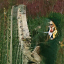

In [5]:
display(image)

# Onestep Sampling
image = pipe(num_inference_steps=1).images[0]

In [12]:
import torchvision
import numpy as np
def pilimg_to_tensor(pil_img):
  t = torchvision.transforms.ToTensor()(pil_img)
  t = 2*t-1 # [0,1]->[-1,1]
  t = t.unsqueeze(0)
  t = t.to(device)
  return(t)

def display_as_pilimg(t):
  t = 0.5+0.5*t.to('cpu')
  t = t.squeeze()
  t = t.clamp(0.,1.)
  pil_img = torchvision.transforms.ToPILImage()(t)
  display(pil_img)
  return(pil_img)

idx = np.random.randint(1000)
print('Image', str(idx).zfill(5))
# img_pil = Image.open('ffhq256-1k-validation/'+str(idx).zfill(5)+'.png')
img_pil = Image.open(path / Path('ffhq256-1k-validation/'+str(idx).zfill(5)+'.png'))

display(img_pil)
display_as_pilimg(pilimg_to_tensor(img_pil));


Image 00501


NameError: name 'path' is not defined

cuda:0
original image 00012.png


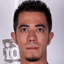

noisy measurement


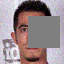

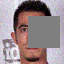

In [13]:
from PIL import Image
# Parameters for 64x64 images
h, w = 64, 64
hcrop, wcrop = h // 2, w // 2
corner_top, corner_left = h // 4, int(0.45 * w)

# Create mask: Initialize with ones (all visible), then set cropped area to 0 (masked area)
mask = torch.ones((3, h, w), device=device)  # Assuming 3 channels (RGB)
mask[:, corner_top:corner_top + hcrop, corner_left:corner_left + wcrop] = 0

# Define the linear operator
def linear_operator(x):
    x = x * mask
    return x

idx = 12
x_true_pil = Image.open(f'../ffhq256-1k-validation/{str(idx).zfill(5)}.png').resize((64, 64))  # Resize to 64x64
x_true = pilimg_to_tensor(x_true_pil).to(device)  # Assuming pilimg_to_tensor converts PIL to tensor
print(x_true.device)
print("original image", f"{str(idx).zfill(5)}.png")
display_as_pilimg(x_true)  # Assuming display_as_pilimg is your display function

# Noise level for the mask area
sigma_noise = 2 * 10 / 255

# Apply the linear operator and add noise to the masked region
y = linear_operator(x_true.clone()) + sigma_noise * mask * torch.randn_like(x_true)
print("noisy measurement")
display_as_pilimg(y)  # Display noisy image

In [20]:
pipe.unet

UNet2DModel(
  (conv_in): Conv2d(3, 192, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (time_proj): Timesteps()
  (time_embedding): TimestepEmbedding(
    (linear_1): Linear(in_features=192, out_features=768, bias=True)
    (act): SiLU()
    (linear_2): Linear(in_features=768, out_features=768, bias=True)
  )
  (class_embedding): Embedding(1000, 768)
  (down_blocks): ModuleList(
    (0): ResnetDownsampleBlock2D(
      (resnets): ModuleList(
        (0-2): 3 x ResnetBlock2D(
          (norm1): GroupNorm(32, 192, eps=1e-05, affine=True)
          (conv1): Conv2d(192, 192, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (time_emb_proj): Linear(in_features=768, out_features=384, bias=True)
          (norm2): GroupNorm(32, 192, eps=1e-05, affine=True)
          (dropout): Dropout(p=0.0, inplace=False)
          (conv2): Conv2d(192, 192, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (nonlinearity): SiLU()
        )
      )
      (downsamplers): ModuleList(


In [169]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


def zero_shot_inpainting(pipe, x, mask, t_seq, epsilon=1e-5, convert_to_fp16=True, display_every=None):
    """
    Perform zero-shot image editing using the Consistency Model. Assuming the  invertible linear operator is the identity
    
    Args:
    - pipe: Consistency model pipeline
    - x: Reference image tensor
    - t_seq: Sequence of time points (e.g., [t1, t2, ..., tN]) t1 > t2
    - epsilon: Small constant for numerical stability
    
    Returns:
    - The inpainted image tensor
    """
    assert len(t_seq)==1 or t_seq[0]> t_seq[1], "decreasing timesteps"

    class_label = 1
    class_label_unet = pipe.prepare_class_labels(batch_size=1, device=device, class_labels=class_label)
   
    y = x.clone() * (1 - mask)
    display_as_pilimg_bigger(y)

    # Step 2: Sample initial noisy image x
    x = y + torch.randn_like(y) * t_seq[0]  # Sampling from N(y, t1^2 I)
    if convert_to_fp16:
        x = x.to(torch.float16) 
    with torch.no_grad():
    # Step 3: Pass through the model at t0
        # output = pipe.unet(x, t_seq[0], class_labels=class_label_unet)  # Apply the model at time t1
        output = pipe(x, t_seq[0], class_labels=class_label)
    # Extract tensor from output
    x = output.sample 

    # Step 4: Apply the transformation after model output
    x = y.clone()*(1-mask) + x.clone()*mask

    # Step 5: Iterative steps from t2 to tN
    for n in range(1, len(t_seq)):
        t_n = t_seq[n]

        # Step 5.1: Sample noisy image
        x = x + torch.randn_like(x) * torch.sqrt(t_n**2 - epsilon**2)  # N(x, (t_n^2 - epsilon^2) I)

        # Step 5.2: Pass through the model at tn
        with torch.no_grad():
            if convert_to_fp16:
                x = x.to(torch.float16) 
            # output = pipe.unet(x, t_n, class_labels=class_label_unet)  # Apply the model at time tn
            output = pipe(x, t_n, class_labels=class_label)
        # Extract tensor from output
        x = output.sample      
        # Step 5.3: Apply the transformation again after model output
        x = y.clone()*(1-mask) + x.clone()*mask

        if display_every and n % display_every==0:
            _ = display_as_pilimg(x)
    return x

In [95]:
import matplotlib.pyplot as plt

def display_as_pilimg_bigger(t, figsize=(3, 3), title=None):  # Set the desired figure size
    t = 0.5 + 0.5 * t.to('cpu')
    t = t.squeeze()
    t = t.clamp(0., 1.)
    pil_img = torchvision.transforms.ToPILImage()(t)

    # Display using matplotlib
    plt.figure(figsize=figsize)
    if title:
        plt.title(title)
    plt.imshow(pil_img)
    plt.axis('off')  # Hide axes
    plt.show()
    
    return pil_img

In [ ]:
display_as_pilimg_bigger

In [82]:
compute_time_steps(N=40, T=1)

tensor([0.0020, 0.0026, 0.0033, 0.0042, 0.0052, 0.0065, 0.0080, 0.0099, 0.0121,
        0.0147, 0.0178, 0.0214, 0.0257, 0.0306, 0.0363, 0.0430, 0.0506, 0.0594,
        0.0694, 0.0809, 0.0940, 0.1088, 0.1256, 0.1446, 0.1659, 0.1899, 0.2169,
        0.2470, 0.2807, 0.3183, 0.3600, 0.4064, 0.4578, 0.5147, 0.5775, 0.6468,
        0.7231, 0.8070, 0.8990, 1.0000])

In [15]:
from Distillation import compute_time_steps
N = 15
T= 1
timesteps  =  torch.flip(compute_time_steps(N=N, T=T), dims=[0])
print(f"{timesteps=}")
# timesteps=[0.002, 0.003, 0.004, 0.005][::-1]
x_true.to(torch.float16)
res = zero_shot_inpainting(pipe, x_true, mask, timesteps, epsilon=1e-5)
display_as_pilimg_bigger(res, title=f"Sampling using timesteps parameters {N=} {T=}")

timesteps=tensor([1.0000, 0.7404, 0.5408, 0.3893, 0.2757, 0.1918, 0.1308, 0.0872, 0.0568,
        0.0359, 0.0220, 0.0130, 0.0073, 0.0040, 0.0020])


NameError: name 'zero_shot_inpainting' is not defined

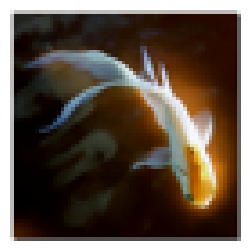

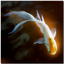

In [74]:
x_true_pil = Image.open(f'imagenet_sample_class1.JPEG').resize((64, 64))  # Resize to 64x64
x_true = pilimg_to_tensor(x_true_pil).to(device) 
display_as_pilimg_bigger(x_true)

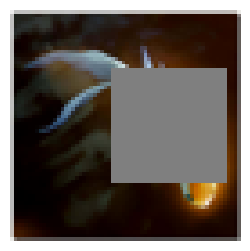

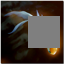

In [76]:
mask = 1 - mask # 1 should indicate missing pixels
display_as_pilimg_bigger(x_true * (1-mask))

In [111]:
pipe_bedroom = ConsistencyModelPipeline.from_pretrained("openai/diffusers-cd_bedroom256_lpips")

model_index.json:   0%|          | 0.00/215 [00:00<?, ?B/s]

Fetching 4 files:   0%|          | 0/4 [00:00<?, ?it/s]

scheduler_config.json:   0%|          | 0.00/243 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/1.06k [00:00<?, ?B/s]

diffusion_pytorch_model.bin:   0%|          | 0.00/2.11G [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/2 [00:00<?, ?it/s]

An error occurred while trying to fetch /raid/home/detectionfeuxdeforet/caillaud_gab/.cache/huggingface/hub/models--openai--diffusers-cd_bedroom256_lpips/snapshots/563e73f9d0efe4841b9e303f1761de90dfad2d77/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /raid/home/detectionfeuxdeforet/caillaud_gab/.cache/huggingface/hub/models--openai--diffusers-cd_bedroom256_lpips/snapshots/563e73f9d0efe4841b9e303f1761de90dfad2d77/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.


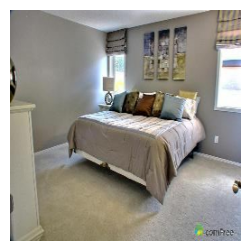

x_true.shape=torch.Size([1, 3, 256, 256])
mask_bed.shape=torch.Size([3, 256, 256])


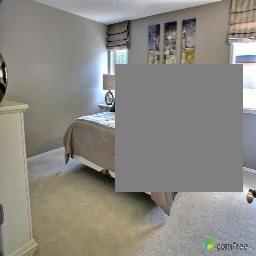

In [170]:
x_true_pil = Image.open(f'LSUN_bedroom_sample.jpg').resize((256, 256))
x_true = pilimg_to_tensor(x_true_pil).to(device) 
res = display_as_pilimg_bigger(x_true)

# mask bedroom
h, w = 256, 256
hcrop, wcrop = h // 2, w // 2
corner_top, corner_left = h // 4, int(0.45 * w)

# Create mask: Initialize with zeros (all visible), then set cropped area to 1 (masked area)
mask_bed = torch.zeros((3, h, w), device=device)  # Assuming 3 channels (RGB)
mask_bed[:, corner_top:corner_top + hcrop, corner_left:corner_left + wcrop] = 1
print(f"{x_true.shape=}")
print(f"{mask_bed.shape=}")
res = display_as_pilimg(x_true*(1-mask_bed))

timesteps=tensor([2.0000, 1.7854, 1.5909, 1.4148, 1.2557, 1.1122, 0.9830, 0.8668, 0.7627,
        0.6694, 0.5861, 0.5119, 0.4458, 0.3872, 0.3354, 0.2896, 0.2492, 0.2138,
        0.1828, 0.1557, 0.1322, 0.1117, 0.0941, 0.0789, 0.0658, 0.0546, 0.0451,
        0.0371, 0.0303, 0.0246, 0.0199, 0.0159, 0.0127, 0.0100, 0.0079, 0.0061,
        0.0047, 0.0036, 0.0027, 0.0020])


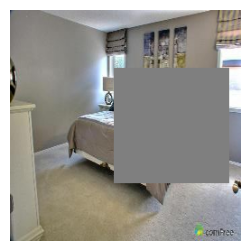

TypeError: ConsistencyModelPipeline.__call__() got multiple values for argument 'class_labels'

In [167]:
N = 40
T= 2
x_true.to(device)
timesteps  =  torch.flip(compute_time_steps(N=N, T=T), dims=[0])
print(f"{timesteps=}")
# timesteps=[0.002, 0.003, 0.004, 0.005][::-1]
pipe_bedroom.unet.to(device)
res = zero_shot_inpainting(pipe_bedroom, x_true, mask_bed, timesteps, epsilon=2e-3, convert_to_fp16=False, display_every = 1)
display_as_pilimg_bigger(res, title=f"Sampling using timesteps parameters {N=} {T=}")

  0%|          | 0/2 [00:00<?, ?it/s]

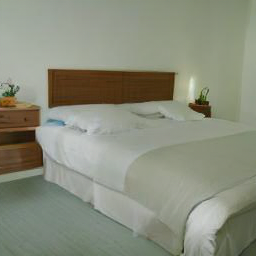

In [174]:
image = pipe_bedroom(num_inference_steps=None, timesteps=[20, 0]).images[0]
display(image)

In [207]:
def zero_shot_inpainting_bedroom(pipe, x, mask, num_inference_steps=40, epsilon=2e-3, convert_to_fp16=True, display_every=None):
    """
    Perform zero-shot image editing using the Consistency Model. Assuming the  invertible linear operator is the identity
    
    Args:
    - pipe: Consistency model pipeline
    - x: Reference image tensor
    - t_seq: Sequence of time points (e.g., [t1, t2, ..., tN]) t1 > t2
    - epsilon: Small constant for numerical stability
    
    Returns:
    - The inpainted image tensor
    """
    y = x.clone() * (1 - mask)
    display_as_pilimg_bigger(y)
    pipe.scheduler.set_timesteps(num_inference_steps)
    timesteps = pipe.scheduler.timesteps
    print(f"{timesteps=}")
    # Step 2: Sample initial noisy image x
    x = y + torch.randn_like(y) * timesteps[0]  # Sampling from N(y, t1^2 I)
    if convert_to_fp16:
        x = x.to(torch.float16) 
    with torch.no_grad():
    # Step 3: Pass through the model at t0
        # output = pipe.unet(x, t_seq[0], class_labels=class_label_unet)  # Apply the model at time t1
        # output = pipe(latents=x,num_inference_steps=num_inference_steps,output_type="pt")
        # output = pipe(latents=x,timesteps=[39],output_type="pt")
        t = timesteps[0]
        print(f"{t=}")
        scaled_sample = pipe.scheduler.scale_model_input(x, t)
        model_output = pipe.unet(scaled_sample, t, class_labels=None, return_dict=False)[0]

        x = pipe.scheduler.step(model_output, t, x, generator=None)[0]

        # output = pipe.unet(x, timesteps[0], class_labels=None, return_dict=False)[0]
    # x = output.images
    print(f"{x.shape=}")
    # Step 4: Apply the transformation after model output
    x = y.clone()*(1-mask) + x.clone()*mask
    _ = display_as_pilimg(x)
    # Step 5: Iterative steps from t2 to tN
    for n in range(1, len(timesteps)):
        t_n = timesteps[n]

        # Step 5.1: Sample noisy image
        x = x + torch.randn_like(x) * torch.sqrt(t_n**2 - epsilon**2)  # N(x, (t_n^2 - epsilon^2) I)

        # Step 5.2: Pass through the model at tn
        with torch.no_grad():
            if convert_to_fp16:
                x = x.to(torch.float16) 
            # output = pipe.unet(x, t_n, class_labels=class_label_unet)  # Apply the model at time tn
            # output = pipe.unet(x, timesteps[n], class_labels=None, return_dict=False)[0]
            scaled_sample = pipe.scheduler.scale_model_input(x, t_n)
            model_output = pipe.unet(scaled_sample, t_n, class_labels=None, return_dict=False)[0]
            x = pipe.scheduler.step(model_output, t_n, x, generator=None)[0]
        # Extract tensor from output
        # x = output.images      
        # Step 5.3: Apply the transformation again after model output
        x = y.clone()*(1-mask) + x.clone()*mask

        if display_every and n % display_every==0:
            _ = display_as_pilimg(x)
    return x

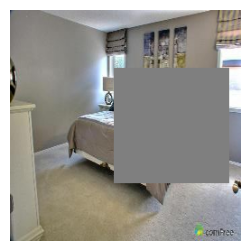

timesteps=tensor([ 1095.5067,  1060.1552,  1024.0748,   987.2349,   949.6027,   911.1435,
          871.8200,   831.5925,   790.4186,   748.2525,   705.0453,   660.7442,
          615.2925,   568.6287,   520.6865,   471.3938,   420.6723,   368.4367,
          314.5939,   259.0417,   201.6680,   142.3495,    80.9495,    17.3166,
          -48.7176,  -117.3416,  -188.7668,  -263.2317,  -341.0065,  -422.3993,
         -507.7631,  -597.5054,  -692.0998,  -792.1010,  -898.1648, -1011.0740,
        -1131.7736, -1261.4188, -1401.4425, -1553.6520], dtype=torch.float64)
t=tensor(1095.5067, dtype=torch.float64)
x.shape=torch.Size([1, 3, 256, 256])


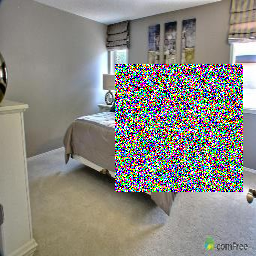

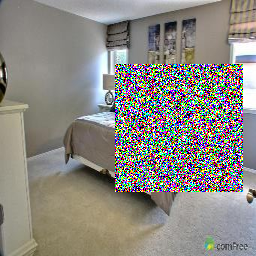

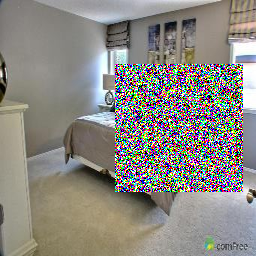

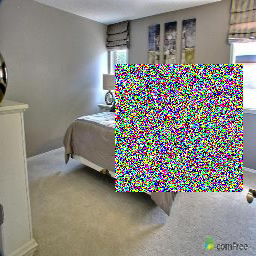

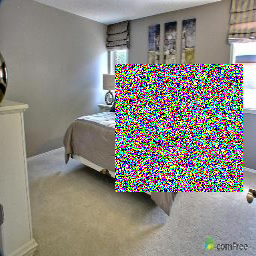

...

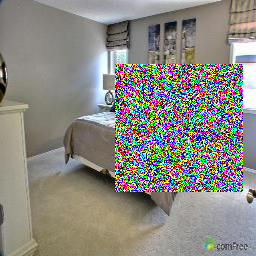

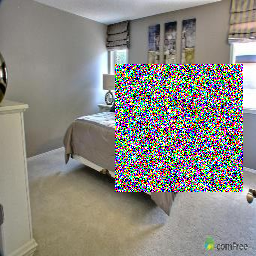

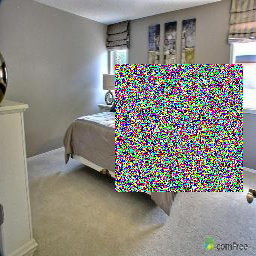

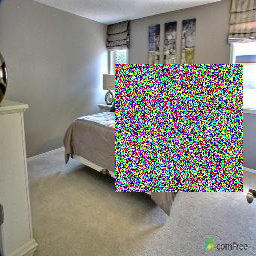

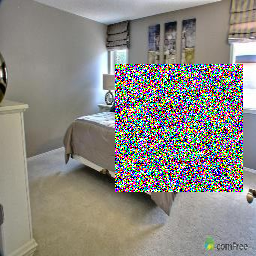

tensor([[[[-0.6627, -0.4510, -0.2863,  ...,  0.2157, -0.1059, -0.0118],
          [-0.5686, -0.3725, -0.2157,  ...,  0.2471, -0.0510,  0.0275],
          [-0.4510, -0.2706, -0.1451,  ...,  0.2235, -0.0510, -0.0039],
          ...,
          [-0.6314, -0.4588, -0.3490,  ...,  0.1843,  0.2706,  0.1137],
          [-0.7412, -0.5529, -0.4118,  ...,  0.0588,  0.0353,  0.1137],
          [-0.8353, -0.6314, -0.4667,  ...,  0.0275,  0.0902,  0.1843]],

         [[-0.6235, -0.4039, -0.2314,  ...,  0.0667, -0.2471, -0.1294],
          [-0.5216, -0.3255, -0.1686,  ...,  0.1059, -0.1922, -0.0980],
          [-0.4039, -0.2314, -0.1059,  ...,  0.0824, -0.1765, -0.1059],
          ...,
          [-0.5686, -0.4039, -0.3020,  ...,  0.2863,  0.3725,  0.2157],
          [-0.6784, -0.4824, -0.3412,  ...,  0.1608,  0.1373,  0.2157],
          [-0.7725, -0.5686, -0.3961,  ...,  0.1373,  0.1922,  0.2863]],

         [[-0.4824, -0.2863, -0.1451,  ..., -0.0353, -0.3098, -0.1843],
          [-0.3804, -0.2157, -

In [208]:
zero_shot_inpainting_bedroom(pipe_bedroom, x_true, mask_bed, num_inference_steps=40,convert_to_fp16=False,  epsilon=2e-3, display_every=1)

In [189]:
sum(p.numel() for p in pipe_bedroom.unet.parameters())

526304771

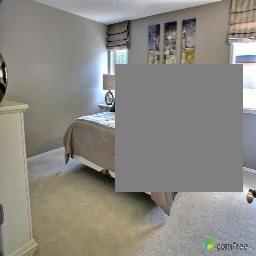

timesteps=tensor([ 1095.5067,  1060.1552,  1024.0748,   987.2349,   949.6027,   911.1435,
          871.8200,   831.5925,   790.4186,   748.2525,   705.0453,   660.7442,
          615.2925,   568.6287,   520.6865,   471.3938,   420.6723,   368.4367,
          314.5939,   259.0417,   201.6680,   142.3495,    80.9495,    17.3166,
          -48.7176,  -117.3416,  -188.7668,  -263.2317,  -341.0065,  -422.3993,
         -507.7631,  -597.5054,  -692.0998,  -792.1010,  -898.1648, -1011.0740,
        -1131.7736, -1261.4188, -1401.4425, -1553.6520], dtype=torch.float64)


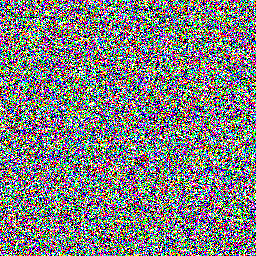

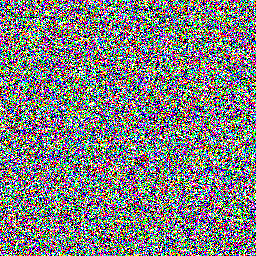

In [216]:
mask = mask_bed  
x = x_true
y = x.clone() * (1 - mask)
display_as_pilimg(y)
pipe_bedroom.scheduler.set_timesteps(num_inference_steps=40)
timesteps = pipe_bedroom.scheduler.timesteps
print(f"{timesteps=}")
# Step 2: Sample initial noisy image x
x = y + torch.randn_like(y) * timesteps[0] 
display_as_pilimg(x)

In [223]:
pipe_bedroom.scheduler.config

FrozenDict([('num_train_timesteps', 40),
            ('sigma_min', 0.002),
            ('sigma_max', 80.0),
            ('sigma_data', 0.5),
            ('s_noise', 1.0),
            ('rho', 7.0),
            ('clip_denoised', True),
            ('_class_name', 'CMStochasticIterativeScheduler'),
            ('_diffusers_version', '0.32.2')])

In [224]:
output = pipe_bedroom(latents=x,timesteps=[40],output_type="pt").images
display_as_pilimg(output)

Both `num_inference_steps`: 1 and `timesteps`: [40] are supplied; `timesteps` will be used over `num_inference_steps`.


ValueError: `timesteps` must start before `self.config.train_timesteps`: 40.

## code de OpenAI

In [356]:
def create_square_mask(img_size):
    h,w = img_size, img_size
    hcrop, wcrop = h // 2, w // 2
    corner_top, corner_left = h // 4, int(0.45 * w)

    # Create mask: Initialize with ones (all visible), then set cropped area to 0 (masked area)
    mask = torch.ones((3, h, w), device=device)  # Assuming 3 channels (RGB)
    mask[:, corner_top:corner_top + hcrop, corner_left:corner_left + wcrop] = 0
    return mask

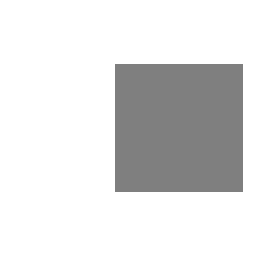

In [357]:
mask = create_square_mask(256)
_ = display_as_pilimg(mask)

In [326]:
sigma_data: float = 0.5
sigma_max=80.0
sigma_min=0.002
rho=7.0
weight_schedule="karras",

def append_dims(x, target_dims):
    """Appends dimensions to the end of a tensor until it has target_dims dimensions."""
    dims_to_append = target_dims - x.ndim
    if dims_to_append < 0:
        raise ValueError(
            f"input has {x.ndim} dims but target_dims is {target_dims}, which is less"
        )
    return x[(...,) + (None,) * dims_to_append]



def get_scalings_for_boundary_condition(sigma):
    c_skip = sigma_data**2 / (
        (sigma - sigma_min) ** 2 + sigma_data**2
    )
    c_out = (
        (sigma - sigma_min)
        * sigma_data
        / (sigma**2 + sigma_data**2) ** 0.5
    )
    c_in = 1 / (sigma**2 + sigma_data**2) ** 0.5
    return c_skip, c_out, c_in


def denoise(model, x_t, sigmas):
    import torch.distributed as dist

    print(f"{x_t.ndim}")
    c_skip, c_out, c_in = [
        append_dims(x, x_t.ndim)
        for x in get_scalings_for_boundary_condition(sigmas)
    ]
    rescaled_t = 1000 * 0.25 * torch.log(sigmas + 1e-44)
    model_output = model(c_in * x_t, rescaled_t).sample
    denoised = c_out * model_output + c_skip * x_t
    return model_output, denoised

def append_zero(x):
    return torch.cat([x, x.new_zeros([1])])

def get_sigmas_karras(n, sigma_min, sigma_max, rho=7.0, device="cpu"):
    """Constructs the noise schedule of Karras et al. (2022)."""
    ramp = torch.linspace(0, 1, n)
    min_inv_rho = sigma_min ** (1 / rho)
    max_inv_rho = sigma_max ** (1 / rho)
    sigmas = (max_inv_rho + ramp * (min_inv_rho - max_inv_rho)) ** rho
    return append_zero(sigmas).to(device)




In [353]:
def create_s_mask(img_size):
    from PIL import Image, ImageDraw, ImageFont

    # create a blank image with a white background
    img = Image.new("RGB", (img_size, img_size), color="white")

    # get a drawing context for the image
    draw = ImageDraw.Draw(img)

    # load a font
    font_path = "/usr/share/fonts/truetype/dejavu/DejaVuSans-Bold.ttf"
    font = ImageFont.truetype(font_path, 250)
    # draw the letter "C" in black
    draw.text((50, 0), "S", font=font, fill=(0, 0, 0))

    # convert the image to a numpy array
    img_np = np.array(img)
    plt.imshow(img_np)
    img_np = img_np.transpose(2, 0, 1)
    img_th = torch.from_numpy(img_np).to(device)
    display_as_pilimg(img_th)

    img_gray = img.convert("L")

    # Convert the grayscale image to a numpy array
    img_np = np.array(img_gray)

    # Thresholding to create the mask
    # Set pixel values inside the "S" (dark area) to 1, others to 0
    mask = (img_np > 128).astype(np.float32)  # 128 is the threshold

    # Convert the mask to a PyTorch tensor
    mask = torch.from_numpy(mask).to(device)
    print(f"{mask.shape=}")
    return mask


@torch.no_grad()
def iterative_inpainting(
    pipe,
    images,
    x,
    ts,
    t_min=0.002,
    t_max=80.0,
    rho=7.0,
    steps=40,
    generator=None,
    use_square_mask = False
):
    
    image_size = x.shape[-1]

    if use_square_mask:
        mask=create_square_mask(image_size)

    else:
        mask = create_s_mask(image_size)
    
    def replacement(x0, x1):
        x_mix = x0 * mask + x1 * (1 - mask)
        return x_mix

    t_max_rho = t_max ** (1 / rho)
    t_min_rho = t_min ** (1 / rho)
    s_in = x.new_ones([x.shape[0]])
    print(f"{s_in=}")
    images = replacement(images, -torch.ones_like(images))

    sigmas = get_sigmas_karras(steps, sigma_min, sigma_max, rho, device=device)
 
    for i in range(len(ts) - 1):
        t = (t_max_rho + ts[i] / (steps - 1) * (t_min_rho - t_max_rho)) ** rho
        print(f"Timestep T={ts[i]}")
        # x0 = distiller(x, t * s_in).sample
        x0 = denoise(pipe, x, sigmas[i])[1]

        x0 = torch.clamp(x0, -1.0, 1.0)
        x0 = replacement(images, x0)
        display_as_pilimg(x0)
        next_t = (t_max_rho + ts[i + 1] / (steps - 1) * (t_min_rho - t_max_rho)) ** rho
        next_t = np.clip(next_t, t_min, t_max)
        x = x0 + torch.randn_like(x) * np.sqrt(next_t**2 - t_min**2)

    return x, images


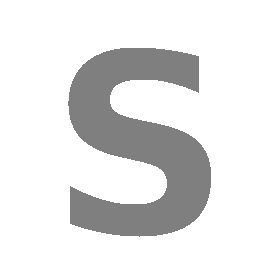

mask.shape=torch.Size([256, 256])
s_in=tensor([1.], device='cuda:0')
Timestep T=40
4


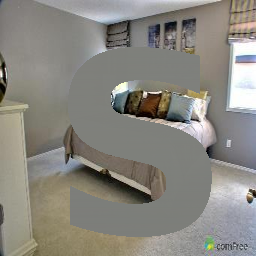

Timestep T=39
4


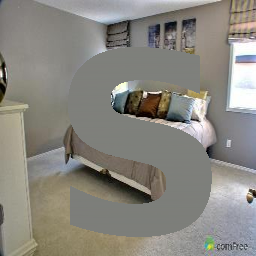

Timestep T=38
4


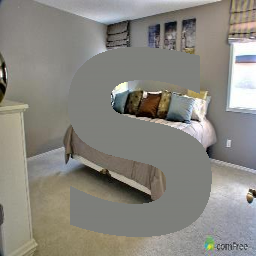

Timestep T=37
4


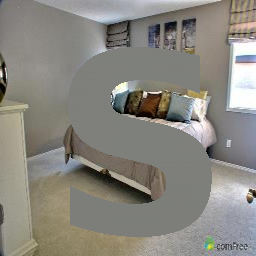

Timestep T=36
4


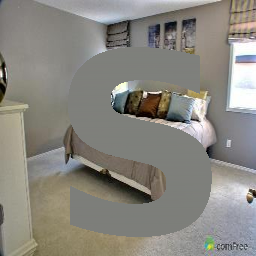

Timestep T=35
4


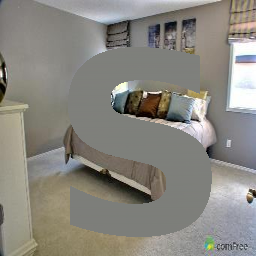

Timestep T=34
4


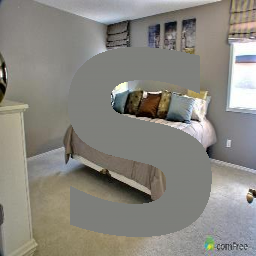

Timestep T=33
4


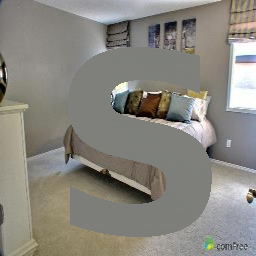

Timestep T=32
4


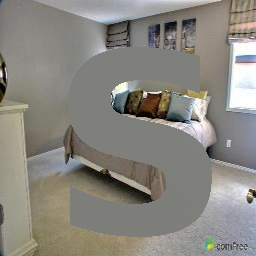

Timestep T=31
4


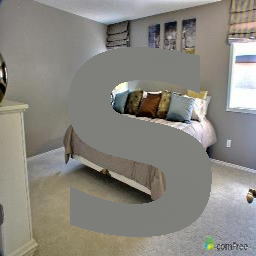

Timestep T=30
4


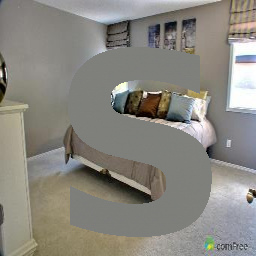

Timestep T=29
4


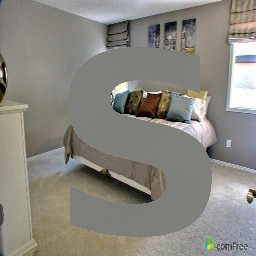

Timestep T=28
4


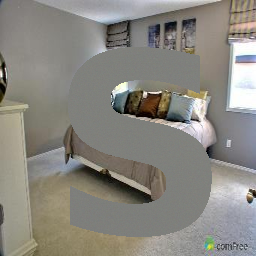

Timestep T=27
4


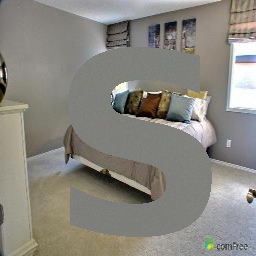

Timestep T=26
4


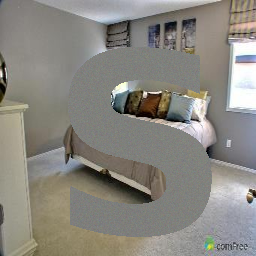

Timestep T=25
4


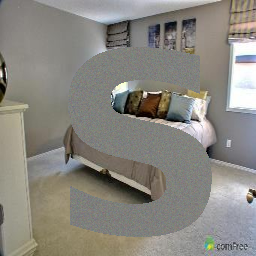

Timestep T=24
4


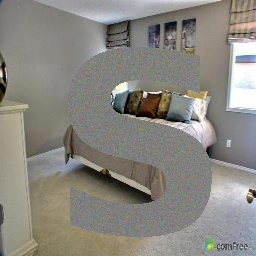

Timestep T=23
4


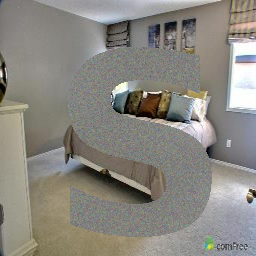

Timestep T=22
4


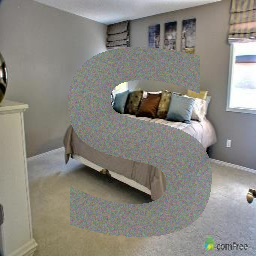

Timestep T=21
4


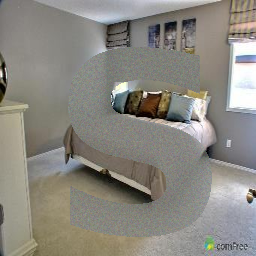

Timestep T=20
4


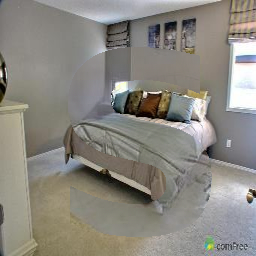

Timestep T=19
4


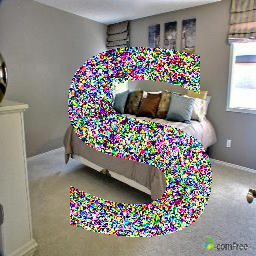

Timestep T=18
4


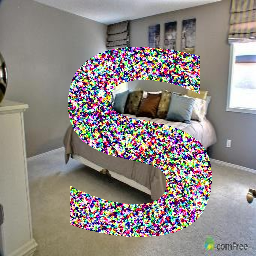

Timestep T=17
4


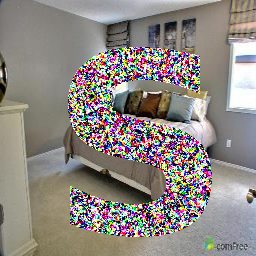

Timestep T=16
4


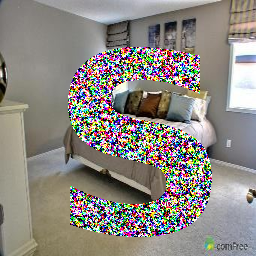

Timestep T=15
4


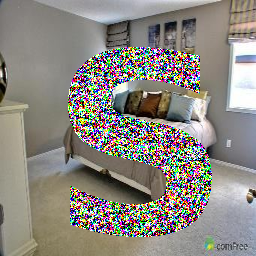

Timestep T=14
4


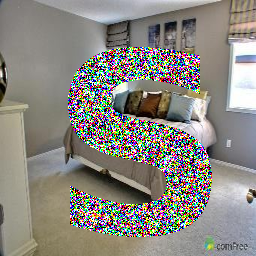

Timestep T=13
4


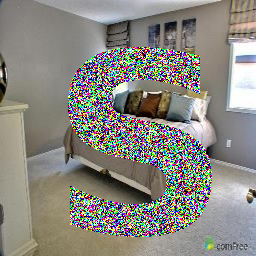

Timestep T=12
4


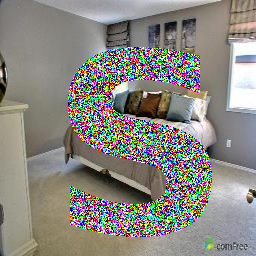

Timestep T=11
4


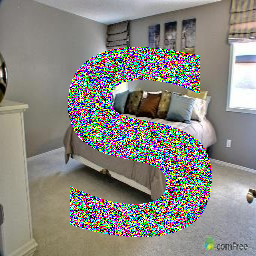

Timestep T=10
4


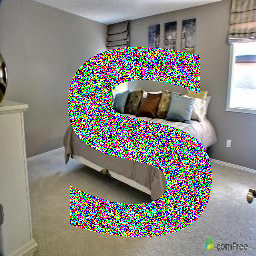

Timestep T=9
4


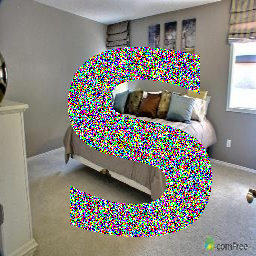

Timestep T=8
4


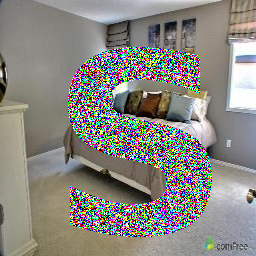

Timestep T=7
4


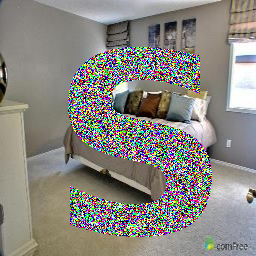

Timestep T=6
4


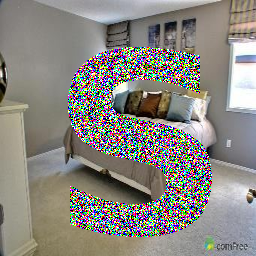

Timestep T=5
4


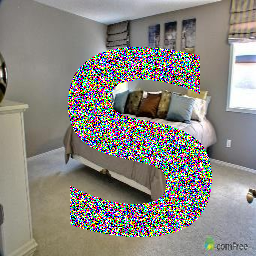

Timestep T=4
4


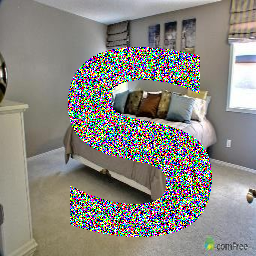

Timestep T=3
4


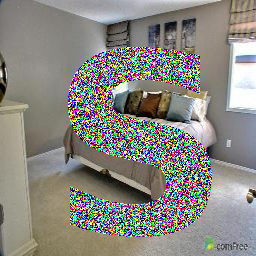

Timestep T=2
4


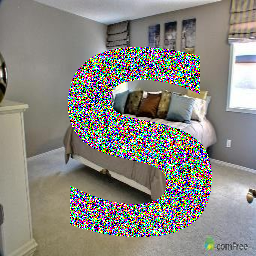

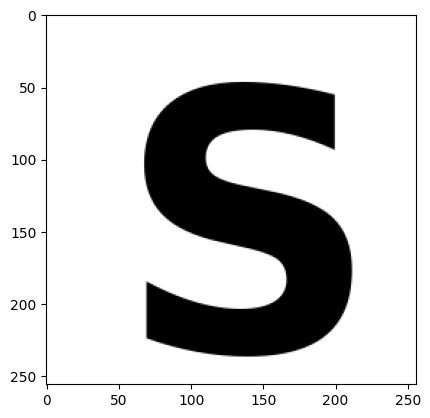

In [342]:
x, images = iterative_inpainting(
    pipe_bedroom.unet,
    images=x_true,
    x=x_true.clone(),
    ts=[i for i in range(40,0,-1)])

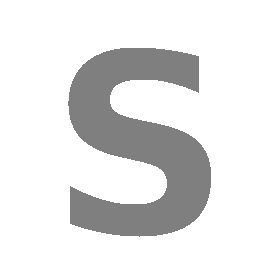

mask.shape=torch.Size([256, 256])
s_in=tensor([1.], device='cuda:0')
Timestep T=40
4


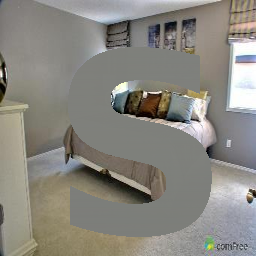

Timestep T=39
4


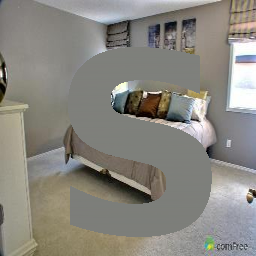

Timestep T=38
4


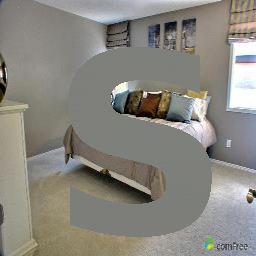

Timestep T=37
4


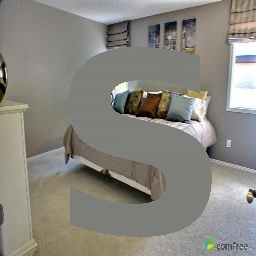

Timestep T=36
4


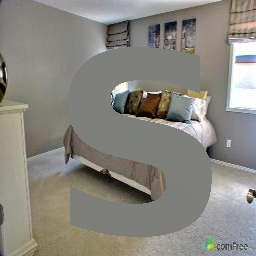

Timestep T=35
4


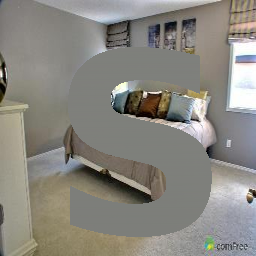

Timestep T=34
4


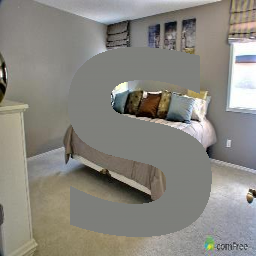

Timestep T=33
4


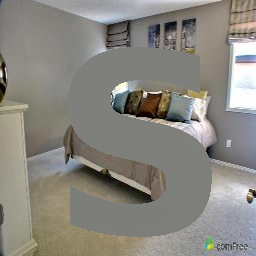

Timestep T=32
4


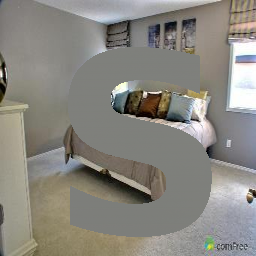

Timestep T=31
4


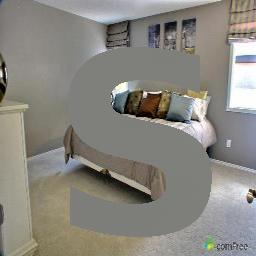

Timestep T=30
4


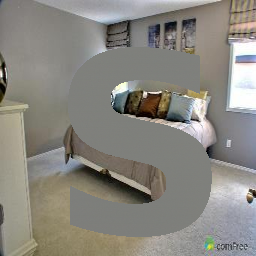

Timestep T=29
4


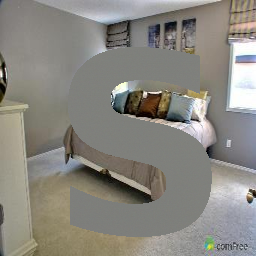

Timestep T=28
4


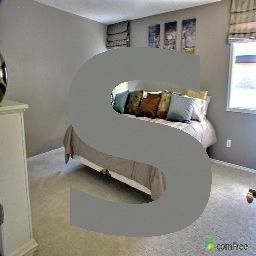

Timestep T=27
4


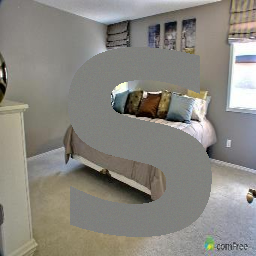

Timestep T=26
4


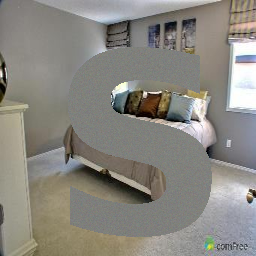

Timestep T=25
4


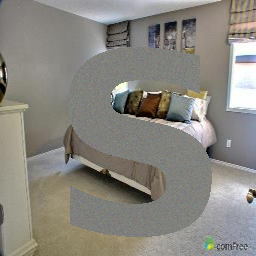

Timestep T=24
4


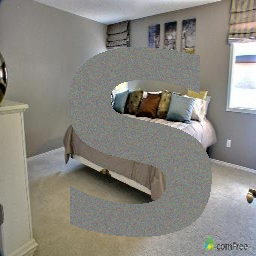

Timestep T=23
4


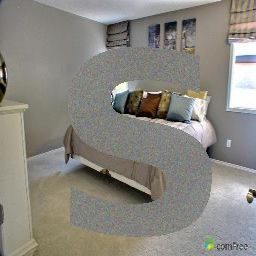

Timestep T=22
4


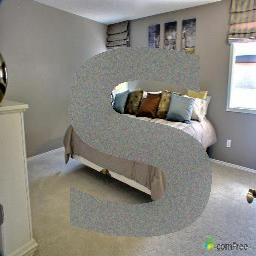

Timestep T=21
4


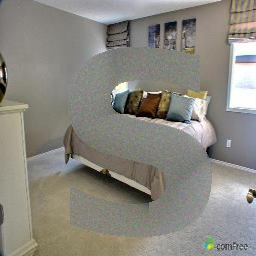

Timestep T=20
4


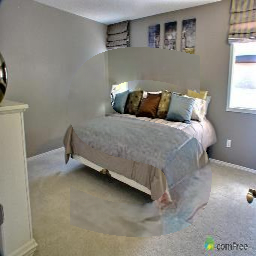

Timestep T=19
4


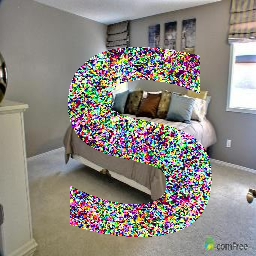

Timestep T=18
4


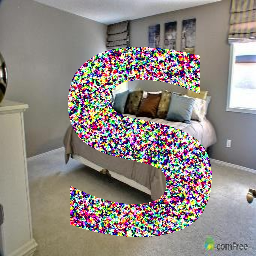

Timestep T=17
4


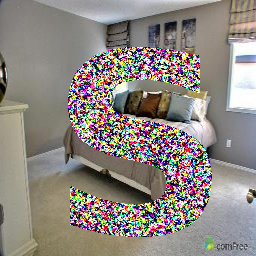

Timestep T=16
4


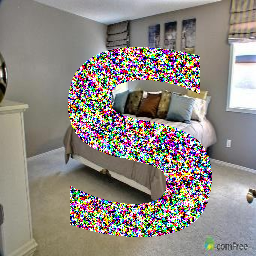

Timestep T=15
4


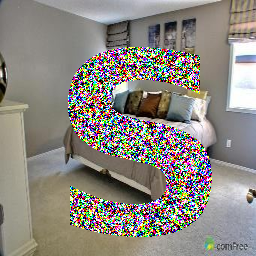

Timestep T=14
4


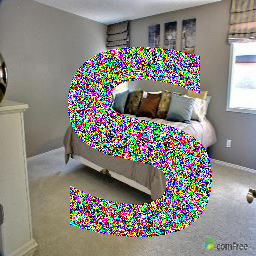

Timestep T=13
4


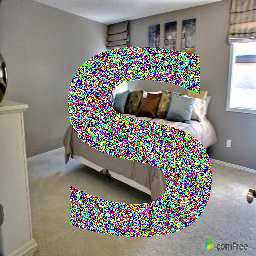

Timestep T=12
4


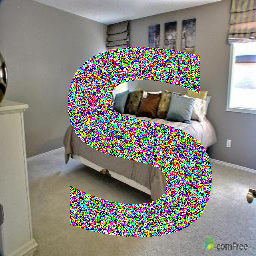

Timestep T=11
4


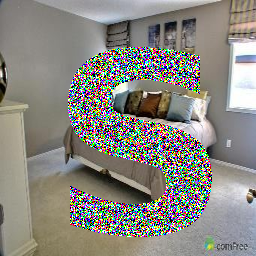

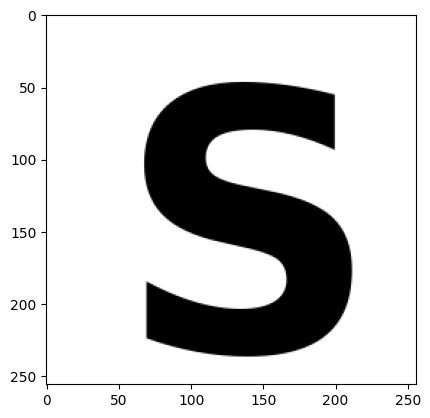

In [344]:
x, images = iterative_inpainting(
    pipe_bedroom.unet,
    images=x_true,
    x=x_true.clone(),
    ts=[i for i in range(40,9,-1)])

s_in=tensor([1.], device='cuda:0')
Timestep T=40
4


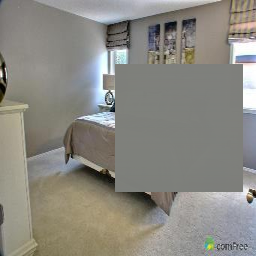

Timestep T=39
4


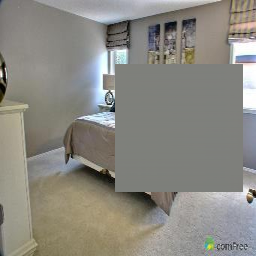

Timestep T=38
4


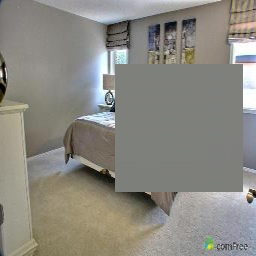

Timestep T=37
4


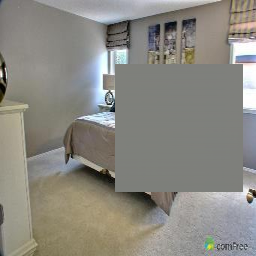

Timestep T=36
4


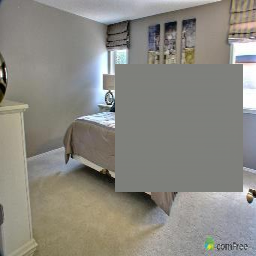

Timestep T=35
4


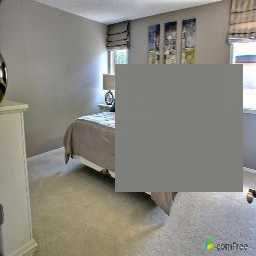

Timestep T=34
4


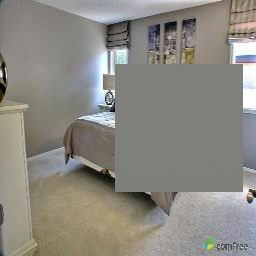

Timestep T=33
4


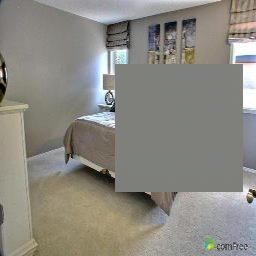

Timestep T=32
4


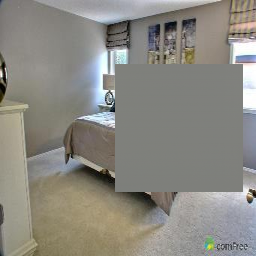

Timestep T=31
4


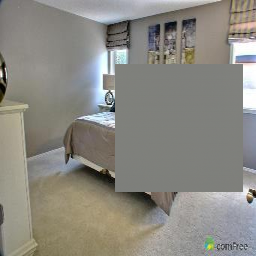

Timestep T=30
4


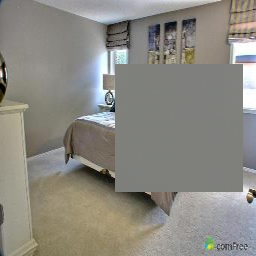

Timestep T=29
4


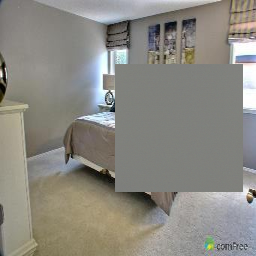

Timestep T=28
4


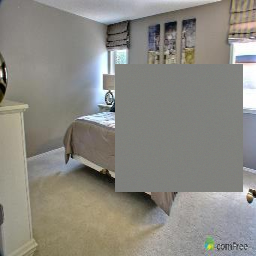

Timestep T=27
4


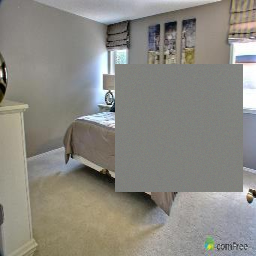

Timestep T=26
4


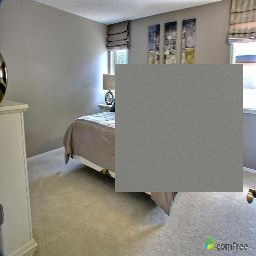

Timestep T=25
4


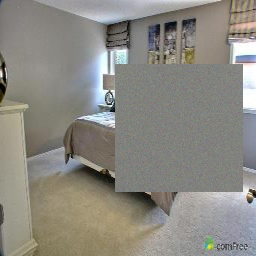

Timestep T=24
4


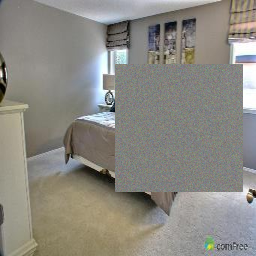

Timestep T=23
4


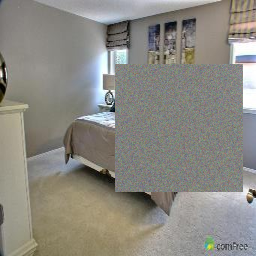

Timestep T=22
4


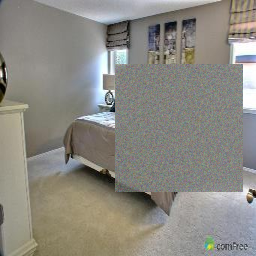

Timestep T=21
4


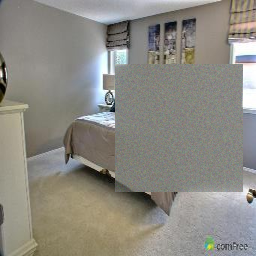

Timestep T=20
4


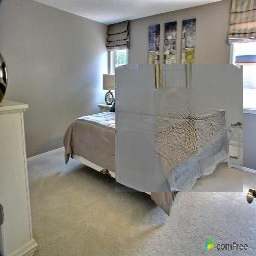

Timestep T=19
4


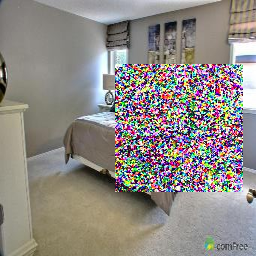

Timestep T=18
4


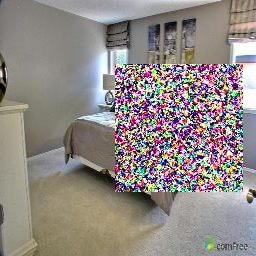

Timestep T=17
4


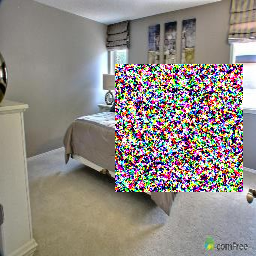

Timestep T=16
4


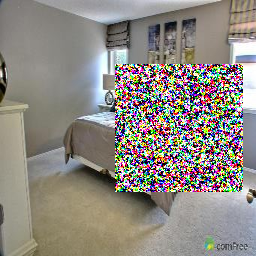

Timestep T=15
4


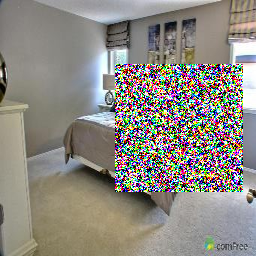

Timestep T=14
4


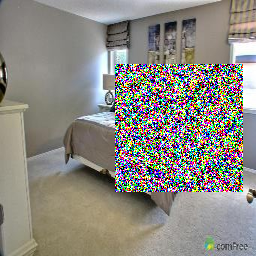

Timestep T=13
4


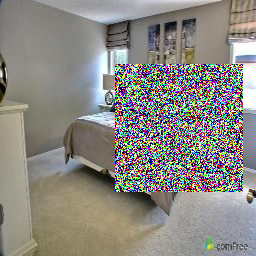

Timestep T=12
4


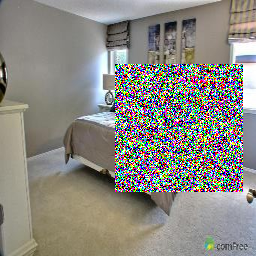

Timestep T=11
4


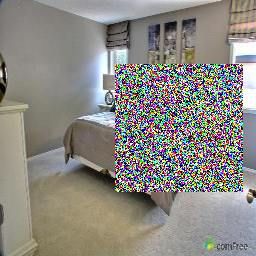

Timestep T=10
4


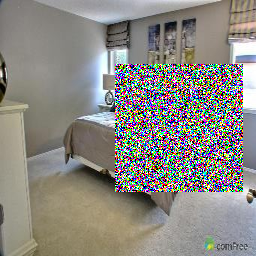

Timestep T=9
4


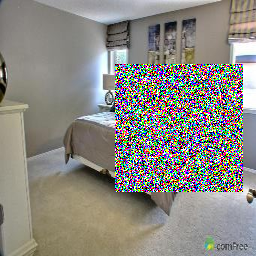

Timestep T=8
4


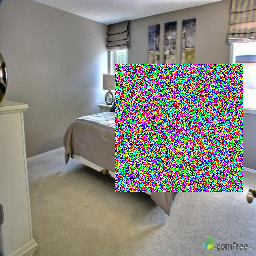

Timestep T=7
4


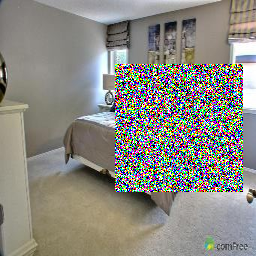

Timestep T=6
4


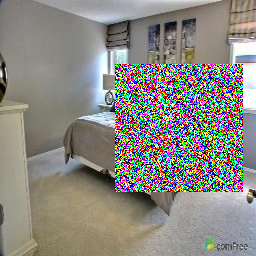

Timestep T=5
4


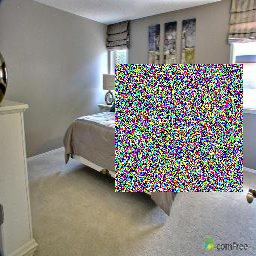

Timestep T=4
4


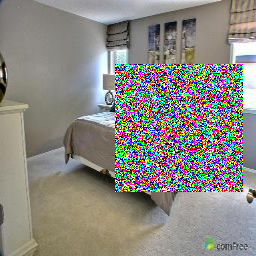

Timestep T=3
4


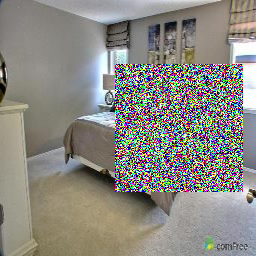

In [359]:
x, images = iterative_inpainting(
    pipe_bedroom.unet,
    images=x_true,
    x=x_true.clone(),
    ts=[i for i in range(40,1,-1)], use_square_mask=True)

# Try on ImageNet

In [2]:
%load_ext autoreload
%autoreload 2

Loading pipeline components...:   0%|          | 0/2 [00:00<?, ?it/s]

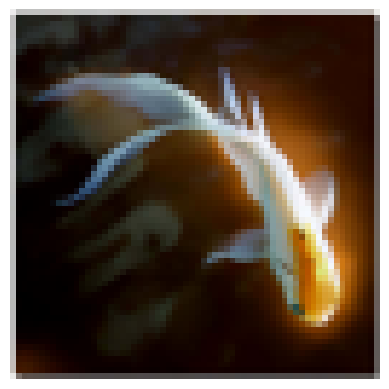

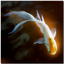

In [6]:
from consistency_inpainting import create_square_mask,iterative_inpainting, pilimg_to_tensor, display_as_pilimg
from PIL import Image
from diffusers import ConsistencyModelPipeline
import torch
device = "cuda" if torch.cuda.is_available() else "cpu"
# Load the cd_imagenet64_l2 checkpoint.
model_id_or_path = "openai/diffusers-cd_imagenet64_l2"
pipe = ConsistencyModelPipeline.from_pretrained(model_id_or_path, torch_dtype=torch.float16)
pipe.to(device)

x_true_pil = Image.open(f'imagenet_sample_class1.JPEG').resize((64, 64))  # Resize to 64x64
x_true = pilimg_to_tensor(x_true_pil).to(device) 
display_as_pilimg(x_true)

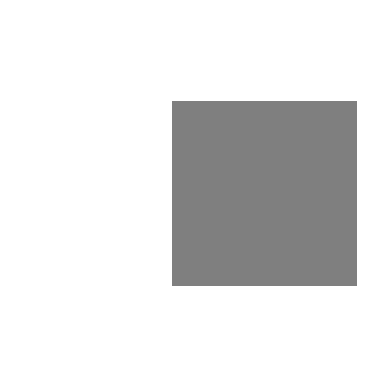

s_in=tensor([1.], device='cuda:0')
Timestep T=40


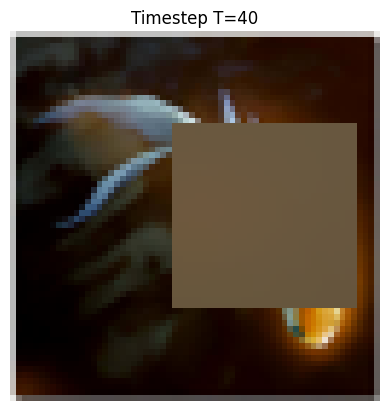

Timestep T=39


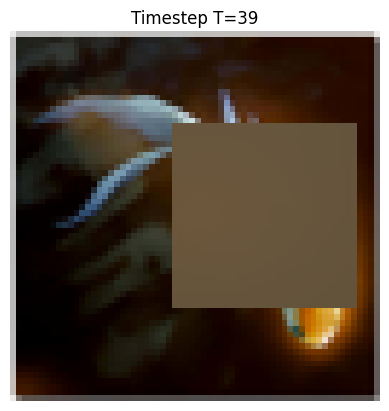

Timestep T=38


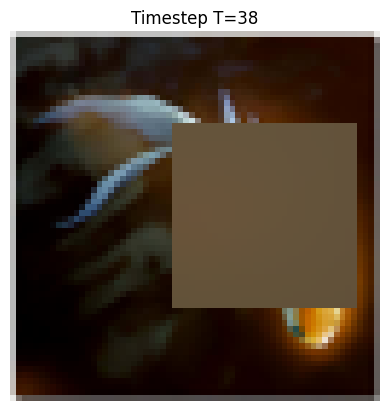

Timestep T=37


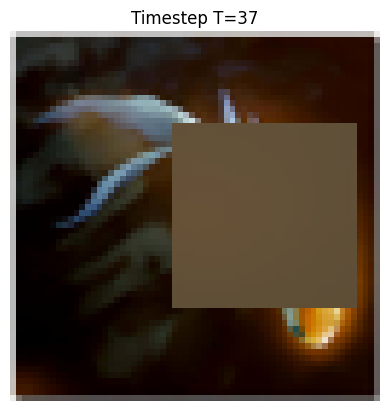

Timestep T=36


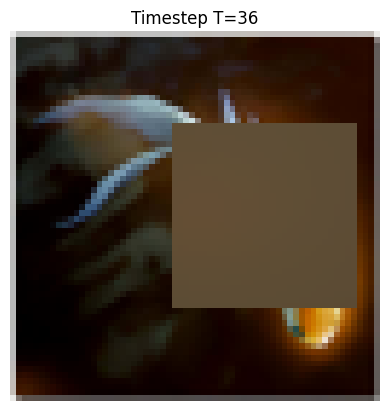

Timestep T=35


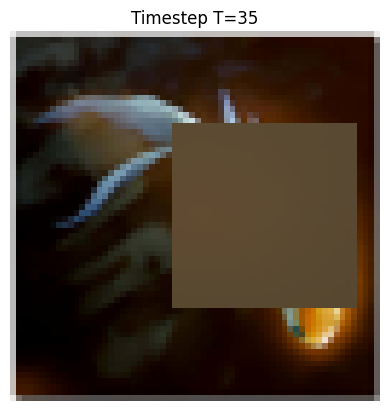

Timestep T=34


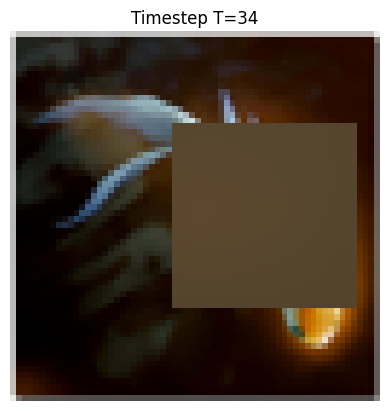

Timestep T=33


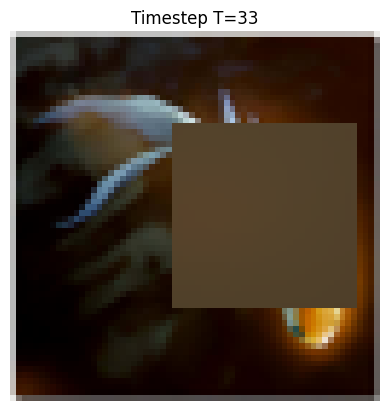

Timestep T=32


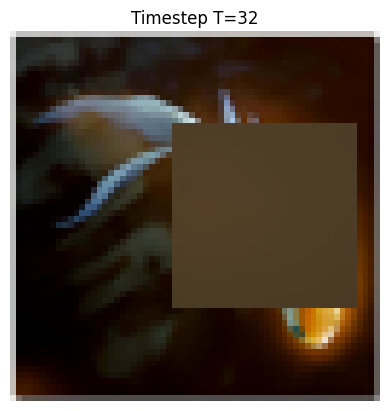

Timestep T=31


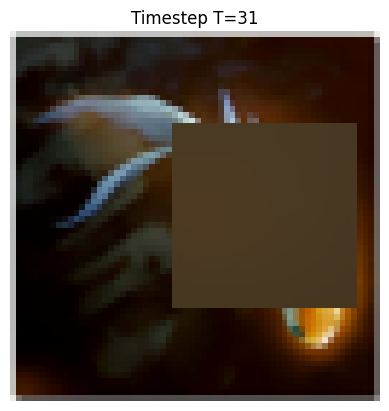

Timestep T=30


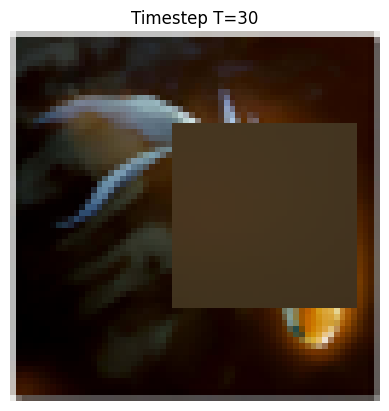

Timestep T=29


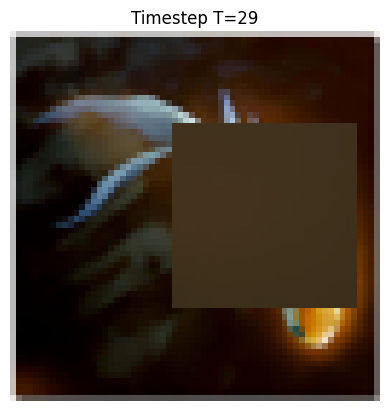

Timestep T=28


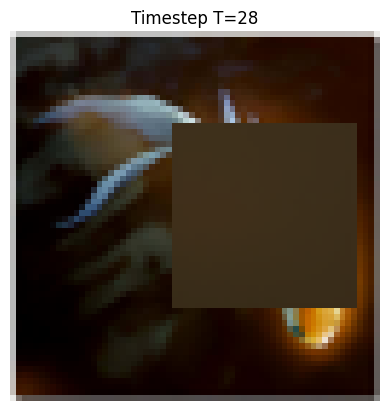

Timestep T=27


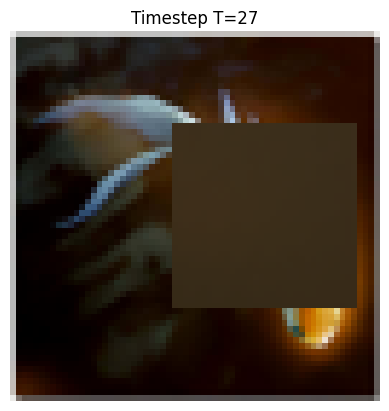

Timestep T=26


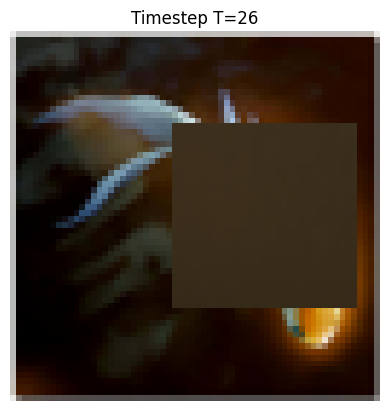

Timestep T=25


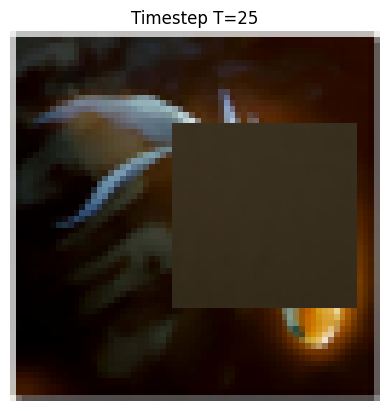

Timestep T=24


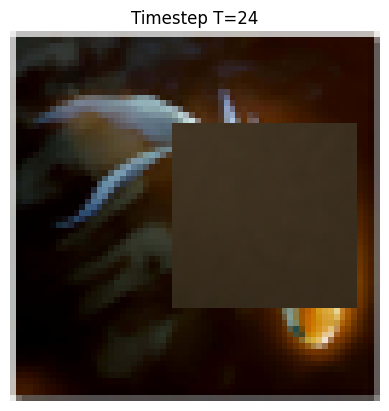

Timestep T=23


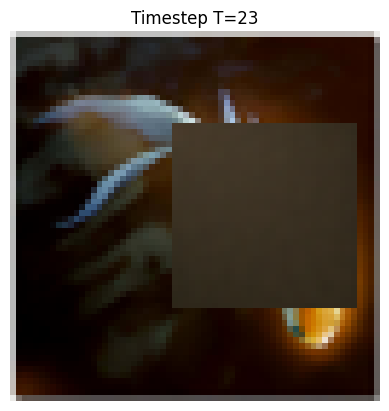

Timestep T=22


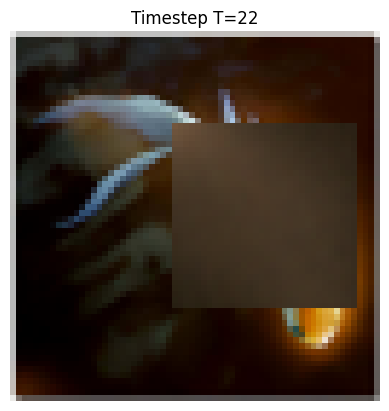

Timestep T=21


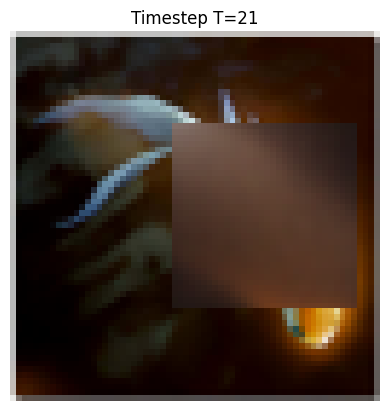

Timestep T=20


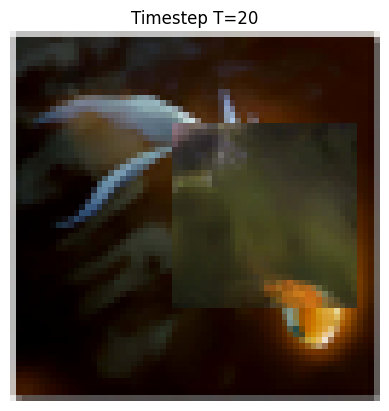

Timestep T=19


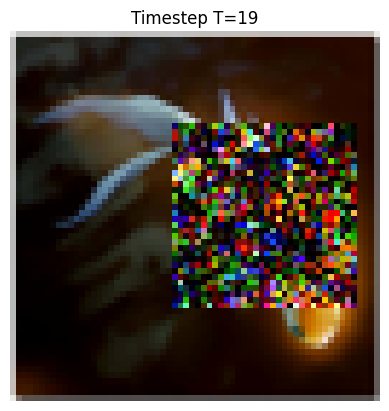

Timestep T=18


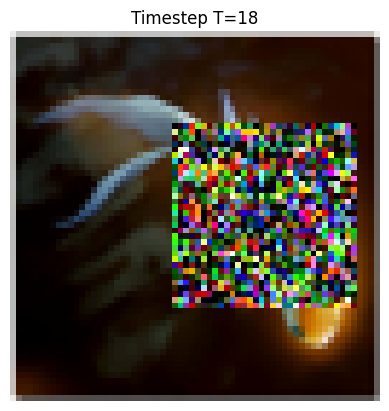

Timestep T=17


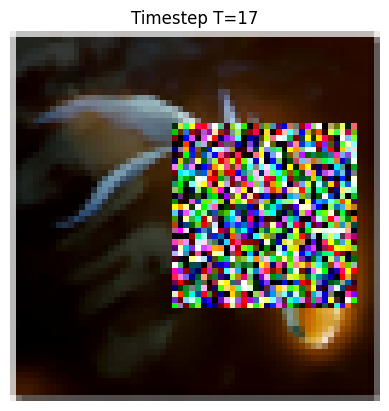

Timestep T=16


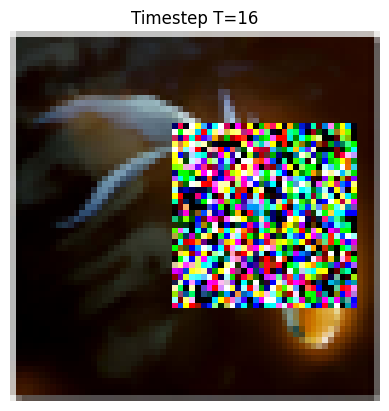

Timestep T=15


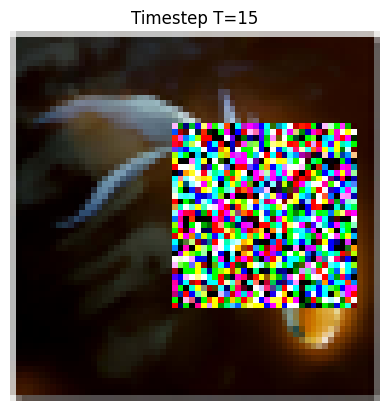

Timestep T=14


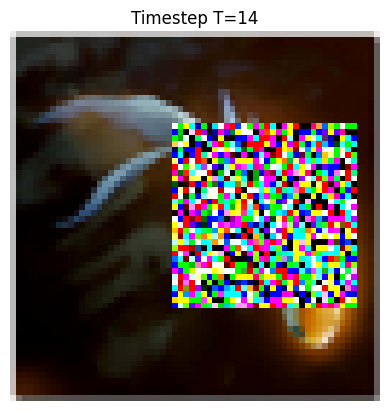

Timestep T=13


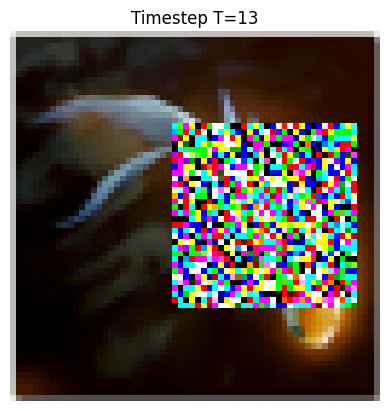

Timestep T=12


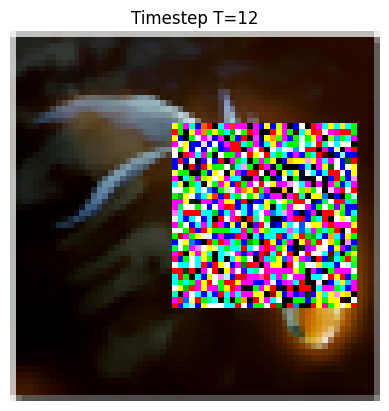

Timestep T=11


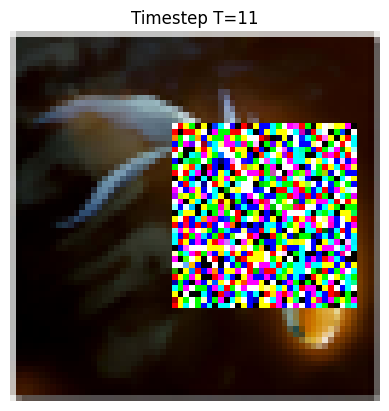

Timestep T=10


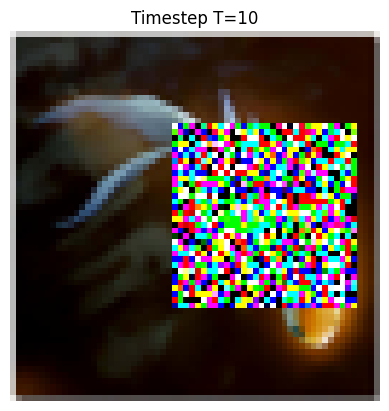

Timestep T=9


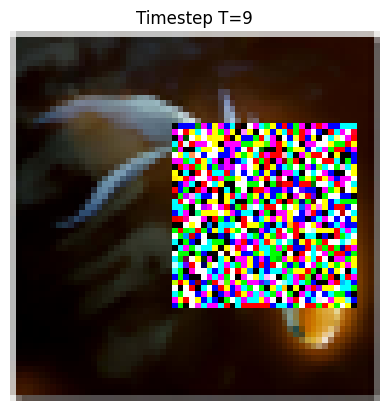

Timestep T=8


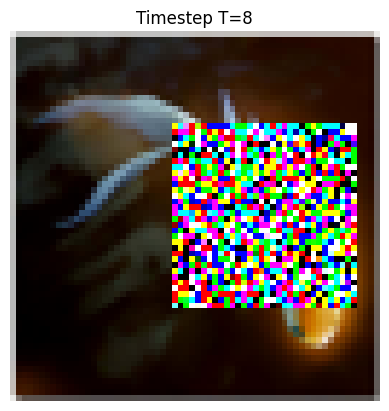

Timestep T=7


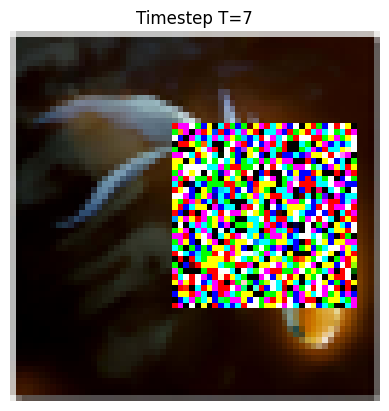

Timestep T=6


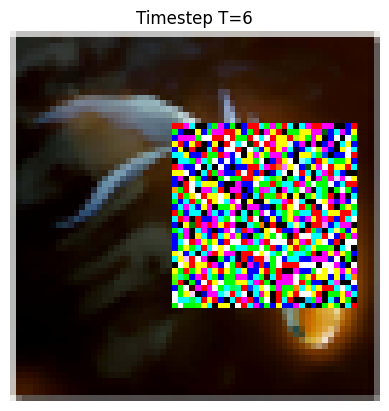

Timestep T=5


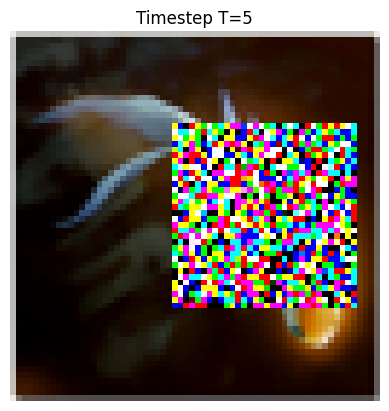

Timestep T=4


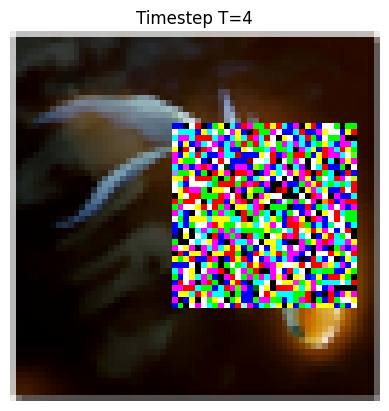

Timestep T=3


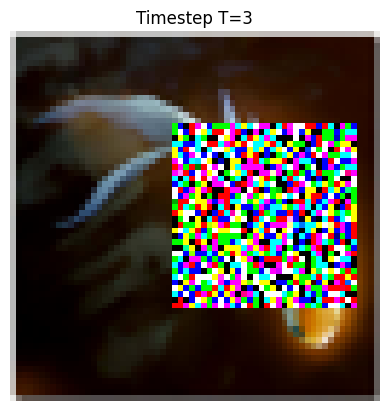

Timestep T=2


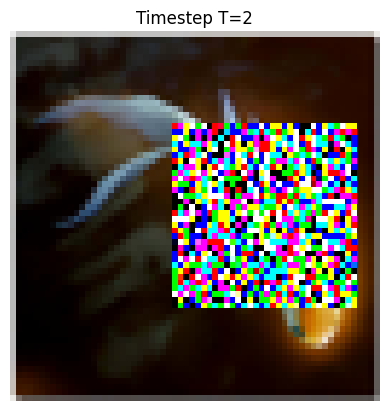

(tensor([[[[ 138.0125,  -32.1678, -122.4167,  ..., -146.0033,  -95.8213,
             115.2308],
           [ -13.0343,   53.8398,   29.6504,  ...,  -11.7492,  -10.8725,
             -15.2458],
           [ -62.8004,    4.9691,   54.8672,  ...,  -55.5766,   48.4263,
             114.3342],
           ...,
           [ -78.1675, -107.9773,  -40.1074,  ...,  -81.8773,    4.0834,
              -5.2588],
           [ 120.8454,    3.5816,   61.3616,  ...,   36.8402,   70.3800,
            -127.8968],
           [ 121.4498,   70.2851,  -12.9896,  ...,  -65.3246,   44.1876,
             -55.1670]],
 
          [[   9.8971,   65.8816,   40.7564,  ...,  170.2223,  109.3109,
              38.0585],
           [  54.5520,    8.6556,  120.1639,  ...,  -16.7432,   36.4501,
              13.6058],
           [-137.6290,  -71.2944,   17.2650,  ...,   43.7797,   33.4666,
             -82.2790],
           ...,
           [  38.2147,  -12.0765,   38.0612,  ...,  -38.8533,  -13.5879,
              17.28

In [24]:
from consistency_inpainting import create_square_mask,iterative_inpainting
iterative_inpainting(pipe=pipe, images=x_true,class_labels=1, is_imagenet=True,
    x=x_true.clone(),
    ts=[i for i in range(40,0,-1)], use_square_mask=True)